In [45]:
!pip3 install seaborn statsmodels plotly

import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import entropy
import numpy as np
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
import statsmodels.api as sm
from statsmodels.regression.mixed_linear_model import MixedLM
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D  
import plotly.express as px
from plotly.subplots import make_subplots
from ipywidgets import widgets
from IPython.display import display, clear_output

# Analysis of ratings in relation to the emotion sentiment study

We seek to perform general analysis of ratings, the relation between ratings and emotional diversity. Seek to answer questions such as: Do films with a larger emotional diversity (multiple emotions expressed during the movie) have better ratings? To what extent does the genre of a movie impacts its rating? What role does the primary/dominant emotion of a movie play?

In [4]:
# Load the dataset
DATAPATH_metadata = "../data_sentiment_analysis/final_dataset.pkl"
DATAPATH_emotions20 = "../data_sentiment_analysis/emotions_interpolated_20.pkl"
DATAPATH_mean_emotion_arcs =  "data/mean_emotion_arcs_k_shape_clusters.pkl"

In [5]:
# Read the datasets
df_metadata = pd.read_pickle(DATAPATH_metadata)
df_emotion = pd.read_pickle(DATAPATH_emotions20)
df_mean_emotion_arcs_k_cluster = pd.read_pickle(DATAPATH_mean_emotion_arcs)

## General description of rating dataset and useful variable definition

In [6]:
# Percentage of missing values of completely scraped column 'Rating'
print(df_metadata["Rating"].isna().sum()/len(df_metadata)*100)

7.151592801817016


In [7]:
# Map countries into their continents
country_mapping = {
    'Asia': [
        'Afghanistan', 'Armenia', 'Azerbaijan', 'Bahrain', 'Bangladesh', 'Bhutan', 'Brunei', 'Cambodia', 'China', 'Cyprus', 'Georgia', 
        'India', 'Indonesia', 'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Lebanon', 'Malaysia', 
        'Maldives', 'Mongolia', 'Myanmar (Burma)', 'Nepal', 'North Korea', 'Oman', 'Pakistan', 'Palestinian Territories', 'Philippines', 
        'Qatar', 'Republic of China (Taiwan)', 'Saudi Arabia', 'Singapore', 'South Korea', 'Sri Lanka', 'Syria', 'Tajikistan', 'Thailand', 
        'Timor-Leste', 'Turkey', 'Turkmenistan', 'United Arab Emirates', 'Uzbekistan', 'Vietnam', 'Yemen',
        "Burma", "Georgian SSR", "Hong Kong", "Iraqi Kurdistan", "Korea", "Macau", "Mandatory Palestine",
        "Palestinian territories", "Republic of China", "Taiwan", "Uzbek SSR", "Soviet Union", "Malayalam Language"
    ],
    'Africa': [
        'Algeria', 'Angola', 'Benin', 'Botswana', 'Burkina Faso', 'Burundi', 'Cabo Verde', 'Cameroon', 'Central African Republic', 'Chad', 
        'Comoros', 'Congo', 'Democratic Republic of the Congo', 'Djibouti', 'Egypt', 'Equatorial Guinea', 'Eritrea', 'Eswatini', 'Ethiopia', 
        'Gabon', 'Gambia', 'Ghana', 'Guinea', 'Guinea-Bissau', 'Ivory Coast (Côte d\'Ivoire)', 'Kenya', 'Lesotho', 'Liberia', 'Libya', 
        'Madagascar', 'Malawi', 'Mali', 'Mauritania', 'Mauritius', 'Morocco', 'Mozambique', 'Namibia', 'Niger', 'Nigeria', 'Rwanda', 'São Tomé and Príncipe', 
        'Senegal', 'Seychelles', 'Sierra Leone', 'Somalia', 'South Africa', 'South Sudan', 'Sudan', 'Togo', 'Tunisia', 'Uganda', 'Zambia', 'Zimbabwe'
    ],
    'Europe': [
        'Albania', 'Andorra', 'Austria', 'Belarus', 'Belgium', 'Bosnia and Herzegovina', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 
        'Denmark', 'Estonia', 'Finland', 'France', 'Georgia', 'Germany', 'Greece', 'Hungary', 'Iceland', 'Ireland', 'Italy', 'Kazakhstan', 
        'Kosovo', 'Latvia', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Malta', 'Moldova', 'Monaco', 'Montenegro', 'Netherlands', 'North Macedonia', 
        'Norway', 'Poland', 'Portugal', 'Romania', 'Russia', 'San Marino', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland', 
        'Ukraine', 'United Kingdom', "Crime", "Czechoslovakia", "England", "Federal Republic of Yugoslavia", "German Democratic Republic",
        "Isle of Man", "Kingdom of Great Britain", "Kingdom of Italy", "Northern Ireland",
        "Republic of Macedonia", "Scotland", "Serbia and Montenegro", "Slovak Republic",
        "Socialist Federal Republic of Yugoslavia", "Soviet occupation zone", "Ukrainian SSR", "Ukranian SSR",
        "Wales", "Weimar Republic", "West Germany", "Yugoslavia", "German Language", "Nazi Germany"
    ],
    'North America': [
        'Canada', 'Costa Rica', 'Cuba', 'Dominican Republic', 'El Salvador', 'Guatemala', 'Haiti', 'Honduras', 'Jamaica', 'Mexico', 
        'Nicaragua', 'Panama', 'United States of America', "Aruba", "Bahamas", "Puerto Rico"
    ],
    'South America': [
        'Argentina', 'Bolivia', 'Brazil', 'Chile', 'Colombia', 'Ecuador', 'Guyana', 'Paraguay', 'Peru', 'Suriname', 'Uruguay', 'Venezuela'
    ],
    'Oceania': [
        'Australia', 'Fiji', 'Kiribati', 'Marshall Islands', 'Micronesia', 'Nauru', 'New Zealand', 'Palau', 'Papua New Guinea', 'Samoa', 
        'Solomon Islands', 'Tonga', 'Tuvalu', 'Vanuatu'
    ]
}

In [8]:
# Separate metadata and emotion general dataset into separete continent ones
NA_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['North America'])]
emotions_NA = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(NA_films['Wikipedia_movie_ID'])]
Asia_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Asia'])]
emotions_Asia = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Asia_films['Wikipedia_movie_ID'])]
Africa_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Africa'])]
emotions_Africa = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Africa_films['Wikipedia_movie_ID'])]
Europe_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Europe'])]
emotions_Europe = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Europe_films['Wikipedia_movie_ID'])]
SA_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['South America'])]
emotions_SA = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(SA_films['Wikipedia_movie_ID'])]
Oceania_films = df_metadata[df_metadata['Movie_countries'].isin(country_mapping['Oceania'])]
emotions_Oceania = df_emotion[df_emotion['Wikipedia_movie_ID'].isin(Oceania_films['Wikipedia_movie_ID'])]

In [50]:
# Variable definitions 
# To display with a prettier name the emotional diversity metrics
metric_display_names = {
    'shannon_entropy': 'Shannon entropy',
    'emotion_transitions': 'Emotion transitions',
    'emotion_variation': 'Emotion variation',
    'unique_dominant_emotions': 'Unique dominant emotions'
}
# Structure to contain all continent data with appropiate titles for display
continent_data = [
    (emotions_Oceania, Oceania_films, "Oceania"),
    (emotions_Africa, Africa_films, "Africa"), 
    (emotions_Europe, Europe_films, "Europe"),
    (emotions_NA, NA_films, "North America"),
    (emotions_SA, SA_films, "South America"),
    (emotions_Asia, Asia_films, "Asia")
]
# List of emotion columns 
emotion_cols = ['anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']
# Map emotions to colors
emotion_colors = {
    "anger": "#FF6666",    # Medium red
    "disgust": "#B266FF",  # Medium purple
    "fear": "#FFB266",     # Medium orange
    "joy": "#66FF66",      # Medium green
    "neutral": "#A9A9A9",  # Medium gray
    "sadness": "#66B2FF",  # Medium blue
    "surprise": "#FFFF66"  # Medium yellow
}
# Map genres to colors
genre_colors = {
    "Action/Adventure": "#6699FF",  # Soft Blue
    "Comedy": "#FFCC66",           # Soft Yellow/Orange
    "Drama": "#66CC99",            # Soft Teal
    "Family/Animation": "#FF9999", # Soft Coral/Red
    "Fantasy/Sci-Fi": "#CC99FF",   # Soft Lavender
    "Horror": "#996666",           # Muted Brown
    "Romance": "#FFB3CC",          # Soft Pink
    "Thriller": "#A9A9A9"          # Neutral Gray
}     

 # List of emotions to analyze
emotions = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise'] 
    

## Movies according to their ending: 'happy', 'sad' or 'neutral' and evaluate ratings, across different categories
Take the n last timesteps and impose a threshold value. Classify all movies into: 'sad' ending, 'happy' ending and 'neutral' ending. Across all categories, see the performance of 'happy' end movies or 'sad' end movies in terms of ratings

In [10]:
def classify_ending(df, n_timesteps=1, threshold=0.9):
    # Get list of unique movies
    movies = df['Wikipedia_movie_ID'].unique()
    
    # Dictionary to store classifications
    endings = {}
    
    for movie_id in movies:
        # Get data for this movie
        movie_data = df[df['Wikipedia_movie_ID'] == movie_id]
        
        # Sort by timestep to ensure we get the last n timesteps
        movie_data = movie_data.sort_values('timestep')
        
        # Get the last n timesteps
        final_timesteps = movie_data.tail(n_timesteps)
        
        # Calculate average joy and sadness for final timesteps
        avg_joy = final_timesteps['joy'].mean()
        avg_sadness = final_timesteps['sadness'].mean()
        
        # Classify ending
        if avg_joy > threshold: # or avg_sadness < (1-threshold):
            endings[movie_id] = 'happy'
        elif avg_sadness > threshold: # or avg_joy < (1-threshold):
            endings[movie_id] = 'sad'
        else:
            endings[movie_id] = 'neutral'
            
        # Store the emotion values for reference
        endings[f"{movie_id}_values"] = {
            'avg_joy': avg_joy,
            'avg_sadness': avg_sadness
        }
    
    return endings

In [11]:
endings = classify_ending(df_emotion)

# Create a summary by directly counting the values
summary = {
    'happy': sum(1 for v in endings.values() if v == 'happy'),
    'sad': sum(1 for v in endings.values() if v == 'sad'),
    'neutral': sum(1 for v in endings.values() if v == 'neutral')
}

print("\nClassification Summary:")
print(summary)


Classification Summary:
{'happy': 1137, 'sad': 729, 'neutral': 32476}


In [12]:
# First filter out the _values entries from the dictionary
filtered_endings = {k: v for k, v in endings.items() if isinstance(k, (int, np.integer))}

# Convert filtered dictionary to dataFrame
endings_df = pd.DataFrame.from_dict(filtered_endings, orient='index', columns=['ending'])

# Reset index to make Wikipedia_movie_ID a column
endings_df = endings_df.reset_index()

# Rename the 'index' column to 'Wikipedia_movie_ID'
endings_df = endings_df.rename(columns={'index': 'Wikipedia_movie_ID'})

# Convert Wikipedia_movie_ID to integer
endings_df['Wikipedia_movie_ID'] = endings_df['Wikipedia_movie_ID'].astype(int)

# Now merge with other dataframe
df_metadata_with_endings = df_metadata.merge(
    endings_df,
    on='Wikipedia_movie_ID',
    how='left'
)

In [13]:
print("\nDistribution of endings:")
print(df_metadata_with_endings['ending'].value_counts())


Distribution of endings:
ending
neutral    32476
happy       1137
sad          729
Name: count, dtype: int64


In [14]:
# First, explode the categories
df_endings_exploded = df_metadata_with_endings[['Wikipedia_movie_ID', 'category', 'ending', 'Rating']].explode('category')

# Get category counts
happy_cats = df_endings_exploded[df_endings_exploded['ending'] == 'happy']['category'].value_counts()
sad_cats = df_endings_exploded[df_endings_exploded['ending'] == 'sad']['category'].value_counts()

# Create figure with subplots
fig_category_distrib_ending = make_subplots(rows=1, cols=2, 
                    specs=[[{'type':'pie'}, {'type':'pie'}]],
                    subplot_titles=['Happy ending movies',
                                  'Sad ending movies'])

# Add happy endings pie chart
fig_category_distrib_ending.add_trace(
    go.Pie(
        labels=happy_cats.index,
        values=happy_cats.values,
        marker=dict(colors=[genre_colors[cat] for cat in happy_cats.index]),
        hovertemplate="<b>%{label}</b><br>" +
                      "Movie count: %{value}<br>" +
                      "<extra></extra>",
        textinfo='label+percent'
    ),
    row=1, col=1
)

# Add sad endings pie chart
fig_category_distrib_ending.add_trace(
    go.Pie(
        labels=sad_cats.index,
        values=sad_cats.values,
        marker=dict(colors=[genre_colors[cat] for cat in sad_cats.index]),
        hovertemplate="<b>%{label}</b><br>" +
                      "Movie count: %{value}<br>" +
                      "<extra></extra>",
        textinfo='label+percent'
    ),
    row=1, col=2
)

# Update layout
fig_category_distrib_ending.update_layout(
    title_text='Category distribution comparison between happy and sad endings',
    title_x=0.5,
    title_y=0.95,
    width=1200,
    height=600,
    showlegend=False
)

In [15]:
fig_category_distrib_ending.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/distribution_by_category_and_ending.html")

### Plot average ratings of 'happy' and 'sad' ending movies for each category


In [16]:
# Calculate means, standard deviations, and counts
summary = df_endings_exploded[df_endings_exploded['ending'].isin(['happy', 'sad'])].groupby(
    ['category', 'ending']
).agg({
    'Rating': ['mean', 'std', 'count']
}).reset_index()

# Flatten multi-level columns
summary.columns = ['category', 'ending', 'mean', 'std', 'count']

# Create positions for bars
categories = sorted(df_endings_exploded['category'].unique())
x = np.arange(len(categories))

# Create figure
fig_avg_rating_ending = go.Figure()

# Add bars for happy endings
happy_data = summary[summary['ending'] == 'happy']
fig_avg_rating_ending.add_trace(go.Bar(
    name='Happy',
    x=happy_data['category'],
    y=happy_data['mean'],
    error_y=dict(type='data', array=happy_data['std'], visible=True),
    marker_color='lightgreen',
    hovertemplate='<b>%{x}</b><br>' +
                  'Ending: happy<br>' +
                  'Average rating: %{y:.2f}<br>' +
                  'Count: %{customdata}<br>' +
                  'Standard deviation: %{error_y.array:.2f}<extra></extra>',
    customdata=happy_data['count']
))

# Add bars for sad endings
sad_data = summary[summary['ending'] == 'sad']
fig_avg_rating_ending.add_trace(go.Bar(
    name='Sad',
    x=sad_data['category'],
    y=sad_data['mean'],
    error_y=dict(type='data', array=sad_data['std'], visible=True),
    marker_color='lightcoral',
    hovertemplate='<b>%{x}</b><br>' +
                  'Ending: sad<br>' +
                  'Average rating: %{y:.2f}<br>' +
                  'Count: %{customdata}<br>' +
                  'Standard deviation: %{error_y.array:.2f}<extra></extra>',
    customdata=sad_data['count']
))

# Update layout
fig_avg_rating_ending.update_layout(
    title='Average ratings by category and ending type',
    xaxis_title='Category',
    yaxis_title='Mean Rating',
    yaxis_range=[4.5, 8],
    barmode='group',
    template='plotly_white',
    legend_title='Ending Type',
    width=1000,
    height=600,
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Arial"
    ),
    # Add x-axis configuration here instead
    xaxis=dict(
        tickangle=45,
        tickfont=dict(size=12)
    )
)

# Show the plot
fig_avg_rating_ending.show()

In [17]:
fig_avg_rating_ending.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/average_ratings_by_category_and_ending.html")

## Emotional diversity metrics, general correlation and OLS with ratings, per continent analysis 
Define the 4 emotional diversity metrics. Perform analysis for whole set of movie, finding correlations. Repeat analysis for each continent

In [18]:
def calculate_emotional_diversity_metrics(df): 
    diversity_metrics = {}
    
    # 1. Shannon Entropy across all timesteps
    def calculate_shannon_entropy(movie_data):
        # Calculate mean emotion values across timesteps
        mean_emotions = movie_data[emotion_cols].mean()
        # Normalize to create probability distribution
        prob_dist = mean_emotions / mean_emotions.sum()
        return entropy(prob_dist)
    
    diversity_metrics['shannon_entropy'] = df.groupby('Wikipedia_movie_ID').apply(calculate_shannon_entropy)
    
    # 2. Emotion Transitions (how often the dominant emotion changes)
    def count_emotion_transitions(movie_data):
        dominant_emotions = movie_data[emotion_cols].idxmax(axis=1)
        transitions = (dominant_emotions != dominant_emotions.shift()).sum()
        return transitions
    
    diversity_metrics['emotion_transitions'] = df.groupby('Wikipedia_movie_ID').apply(count_emotion_transitions)
    
    # 3. Standard deviation of emotions over time
    def calculate_emotion_variation(movie_data):
        return movie_data[emotion_cols].std().mean()
    
    diversity_metrics['emotion_variation'] = df.groupby('Wikipedia_movie_ID').apply(calculate_emotion_variation)
    
    # 4. Count of unique dominant emotions
    def count_unique_dominant_emotions(movie_data):
        dominant_emotions = movie_data[emotion_cols].idxmax(axis=1)
        return dominant_emotions.nunique()
    
    diversity_metrics['unique_dominant_emotions'] = df.groupby('Wikipedia_movie_ID').apply(count_unique_dominant_emotions)
    
    # Combine all metrics into a DataFrame
    diversity_df = pd.DataFrame(diversity_metrics)
    return diversity_df

def analyze_emotion_diversity_vs_ratings(df_general, diversity_metrics): 
    # 1. First, select only needed columns and remove duplicates, excluding NaN ratings
    ratings_clean = df_general[['Wikipedia_movie_ID', 'Rating']].dropna(subset=['Rating']).drop_duplicates()
    # This ensures each movie ID has only one rating and no NaN values

    # 2. Then merge with diversity metrics
    analysis_df = diversity_metrics.merge(ratings_clean, left_index=True, right_on='Wikipedia_movie_ID')
        
    
    # 1. Correlation Analysis
    correlations = {}
    for metric in ['shannon_entropy', 'emotion_transitions', 'emotion_variation', 'unique_dominant_emotions']:
        correlation, p_value = stats.pearsonr(analysis_df[metric], analysis_df['Rating'])
        correlations[metric] = {'correlation': correlation, 'p_value': p_value}
        
    # 2. Linear Regression Analysis
    regression_results = {}
    for metric in ['shannon_entropy', 'emotion_transitions', 'emotion_variation', 'unique_dominant_emotions']:
        X = sm.add_constant(analysis_df[metric])
        model = sm.OLS(analysis_df['Rating'], X).fit()
        regression_results[metric] = model
    
    return correlations, regression_results, analysis_df

def visualize_diversity_analysis(analysis_df, title=None):
   fig, axes = plt.subplots(2, 2, figsize=(15, 15))
   fig.suptitle('Emotional diversity vs movie ratings - ' + title, fontsize=16)
   
   sns.scatterplot(data=analysis_df, x='shannon_entropy', y='Rating', ax=axes[0,0])
   axes[0,0].set_title('Shannon entropy vs ratings')
   sns.regplot(data=analysis_df, x='shannon_entropy', y='Rating', ax=axes[0,0], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='emotion_transitions', y='Rating', ax=axes[0,1])
   axes[0,1].set_title('Emotion transitions vs ratings')
   sns.regplot(data=analysis_df, x='emotion_transitions', y='Rating', ax=axes[0,1], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='emotion_variation', y='Rating', ax=axes[1,0])
   axes[1,0].set_title('Emotion variation vs ratings')
   sns.regplot(data=analysis_df, x='emotion_variation', y='Rating', ax=axes[1,0], scatter=False, color='red')
   
   sns.scatterplot(data=analysis_df, x='unique_dominant_emotions', y='Rating', ax=axes[1,1])
   axes[1,1].set_title('Unique dominant emotions vs ratings')
   sns.regplot(data=analysis_df, x='unique_dominant_emotions', y='Rating', ax=axes[1,1], scatter=False, color='red')
   
   plt.tight_layout()
   return fig

def create_supplementary_visualizations(df, analysis_df, title=None):
    # 1. Distribution of diversity metrics
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle('Distribution of emotional diversity metrics', fontsize=16)
    
    sns.histplot(data=analysis_df, x='shannon_entropy', ax=axes[0,0])
    axes[0,0].set_title('Distribution of shannon entropy')
    
    sns.histplot(data=analysis_df, x='emotion_transitions', ax=axes[0,1])
    axes[0,1].set_title('Distribution of emotion transitions')
    
    sns.histplot(data=analysis_df, x='emotion_variation', ax=axes[1,0])
    axes[1,0].set_title('Distribution of emotion variation')
    
    sns.histplot(data=analysis_df, x='unique_dominant_emotions', ax=axes[1,1])
    axes[1,1].set_title('Distribution of unique dominant emotions')
    
    plt.tight_layout()
    return fig

#### General results, without dividing into continents

C:\Users\inesa\AppData\Local\Temp\ipykernel_16092\782643772.py:12: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_16092\782643772.py:20: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_16092\782643772.py:26: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a f


Correlation analysis for shannon_entropy:
Correlation coefficient: 0.084
P-value: 0.000

Correlation analysis for emotion_transitions:
Correlation coefficient: 0.114
P-value: 0.000

Correlation analysis for emotion_variation:
Correlation coefficient: 0.103
P-value: 0.000

Correlation analysis for unique_dominant_emotions:
Correlation coefficient: 0.094
P-value: 0.000

Regression analysis for shannon_entropy:
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               5.3019      0.064     82.748      0.000       5.176       5.428
shannon_entropy     0.5982      0.040     15.055      0.000       0.520       0.676

Regression analysis for emotion_transitions:
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   5.963

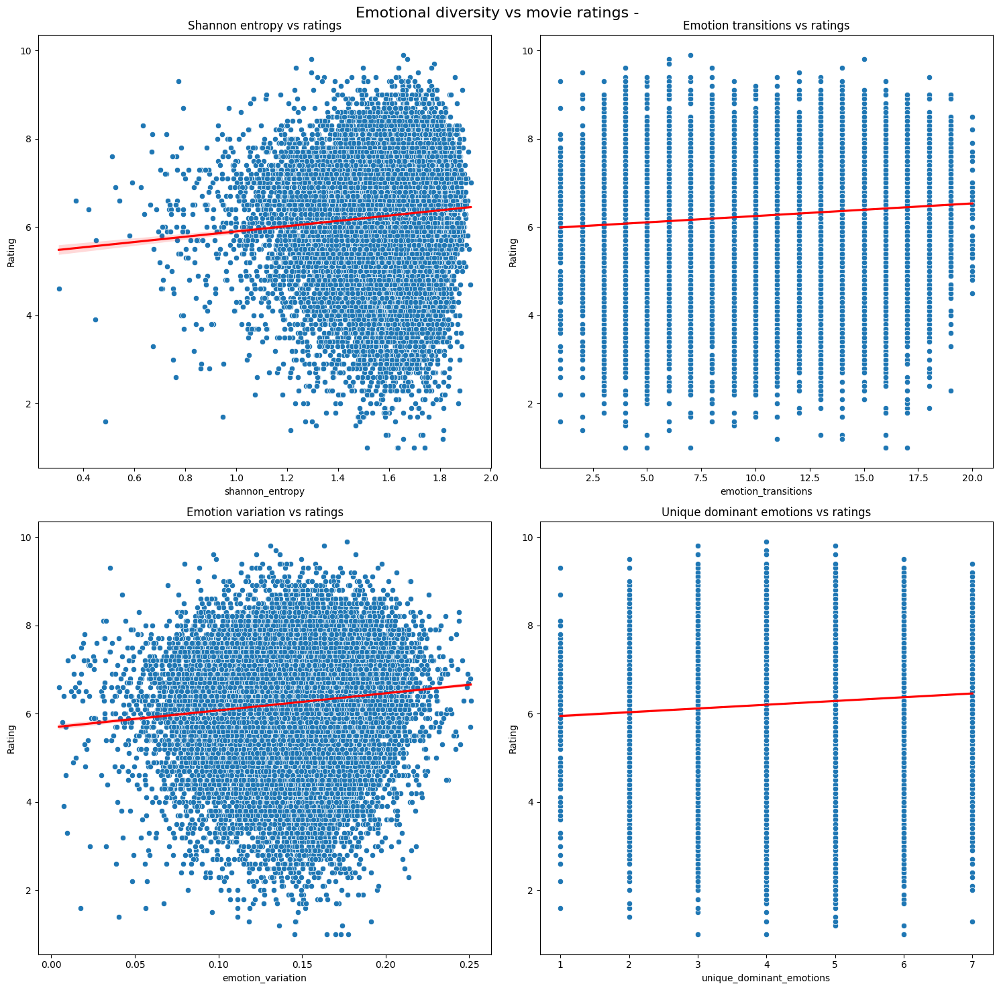

In [19]:
diversity_metrics = calculate_emotional_diversity_metrics(df_emotion)
correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(df_metadata, diversity_metrics)

main_viz = visualize_diversity_analysis(analysis_df,'')
for metric, results in correlations.items():
    print(f"\nCorrelation analysis for {metric}:")
    print(f"Correlation coefficient: {results['correlation']:.3f}")
    print(f"P-value: {results['p_value']:.3f}")

# Print regression results
for metric, model in regression_results.items():
    print(f"\nRegression analysis for {metric}:")
    print(model.summary().tables[1])


In [22]:
# Extract correlation values and p-values from the correlation results
metrics = []
values = []
p_values = []

for metric, results in correlations.items():
    # Use the display name mapping
    display_name = metric_display_names.get(metric, metric)
    metrics.append(display_name)
    values.append(results['correlation'])
    p_values.append(results['p_value'])


# Create figure
fig = go.Figure()

# Add bars with hover information
fig.add_trace(
    go.Bar(
        y=metrics,
        x=values,
        orientation='h',
        customdata=p_values,  
        marker=dict(
            color='rgb(214, 39, 40)',
            line=dict(color='rgb(68, 68, 68)', width=1)
        ),
        hovertemplate='<b>%{y}</b><br>' +
                     'Correlation: %{x:.3f}<br>' +
                     'P-value: %{customdata[0]:.3f} <extra></extra>',
    )
)
 
# Update layout with improved stylings
fig.update_layout(
    title=dict(
        text='Pearson correlation for emotion diversity metrics',
        font=dict(size=24, color='rgb(68, 68, 68)'),
        x=0.5,
        y=0.95
    ),
    xaxis=dict(
        title='Correlation coefficient',
        title_font=dict(size=14),
        tickfont=dict(size=12),
        range=[min(values)-0.02, max(values)+0.02],
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=1,
        gridcolor='lightgrey',
        showgrid=True,
        dtick=0.025,
        tickvals=[0.025, 0.05, 0.075, 0.1, 0.125],
        ticktext=['0.025', '0.05', '0.075', '0.1', '0.125']
    ),
    yaxis=dict(
        title=None,  # Remove y-axis title
        tickfont=dict(size=12),
        autorange='reversed',
        showgrid=False,
        showline=False,
        ticks='',
        showticklabels=True,
        domain=[0.15, 0.85]  # Adjust vertical spacing
    ),
    height=400,
    width=900,
    plot_bgcolor='white',
    paper_bgcolor='white',
    margin=dict(
        l=250,  # Increased left margin for more space between labels and bars
        r=100,
        t=80,
        b=80
    ),
    showlegend=False,
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Arial"
    )
)

# Add more spacing between y-axis labels and bars
fig.update_yaxes(
    ticksuffix='   '  # Add padding after labels
)

fig.show()

In [417]:
fig.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/correlation_general_diversity.html")

### Perform same analysis of correlation of emotion diversity metrics with ratings, for all continents separately

In [23]:
def create_and_save_interactive_diversity_plot(continent_data):
    data_store = {}
    for emotion_dataset, general_dataset, continent in continent_data:
        if continent in ['North America', 'Asia', 'Europe', 'South America']:
            diversity_metrics = calculate_emotional_diversity_metrics(emotion_dataset)
            correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(
                general_dataset, diversity_metrics)
            
            analysis_df['Continent'] = continent
            
            for metric in metric_display_names.keys():
                key = (continent, metric_display_names[metric])
                data_store[key] = {
                    'df': analysis_df,
                    'correlation': correlations[metric]['correlation'],
                    'p_value': correlations[metric]['p_value'],
                    'regression': regression_results[metric],
                    'data_metric': metric
                }
    
    # Create the base figure
    fig = go.Figure()
    
    def create_stat_annotation(continent, metric, data_store):
        key = (continent, metric)
        data = data_store[key]
        
        stats_text = (
            f"<b>Statistical results:</b><br><br>"
            f"<b>Pearson correlation:</b> {data['correlation']:.3f}<br>"
            f"<b>P-value:</b> {data['p_value']:.3e}<br>"
            f"<b>OLS coefficient:</b> {data['regression'].params[1]:.3f}"
        )
        
        return dict(
            text=stats_text,
            x=0.02,
            y=0.98,
            xref="paper",
            yref="paper",
            align="left",
            showarrow=False,
            font=dict(size=12),
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="rgb(68, 68, 68)",
            borderwidth=1,
            borderpad=10,
            xanchor="left",
            yanchor="top"
        )
    
    # Add all traces with visibility=False
    traces_per_combo = 4  # number of traces per continent-metric combination
    for key, data in data_store.items():
        continent, metric_display = key
        data_metric = data['data_metric']
        df = data['df']
        model = data['regression']
        
        # Create sorted x values for smooth line
        x_sorted = np.sort(df[data_metric])
        X_sorted = sm.add_constant(x_sorted)
        
        # Get prediction and confidence intervals
        y_pred = model.get_prediction(X_sorted)
        y_mean = y_pred.predicted_mean
        y_ci = y_pred.conf_int(alpha=0.05)
        
        # Add traces
        fig.add_trace(go.Scatter(
            x=df[data_metric],
            y=df['Rating'],
            mode='markers',
            name='Movies',
            marker=dict(color='#3498db', opacity=0.6, size=8),
            visible=False,
            customdata=np.column_stack((df['Rating'], df[data_metric])),
            hovertemplate='Rating: %{customdata[0]:.2f}<br>Metric value: %{customdata[1]:.2f}<extra></extra>'
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_ci[:, 1],
            mode='lines',
            line=dict(width=0),
            showlegend=False,
            visible=False
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_ci[:, 0],
            mode='lines',
            line=dict(width=0),
            fill='tonexty',
            fillcolor='rgba(231, 76, 60, 0.2)',
            name='95% Confidence interval',
            visible=False
        ))
        
        fig.add_trace(go.Scatter(
            x=x_sorted,
            y=y_mean,
            mode='lines',
            name='Regression line',
            line=dict(color='#e74c3c', width=2),
            visible=False
        ))
    
    # Create dropdown menus
    continents = sorted(list(set(k[0] for k in data_store.keys())))
    metrics = sorted(list(set(k[1] for k in data_store.keys())))
    
    # Use closure to maintain state
    current_selection = {
        'continent': continents[0],
        'metric': metrics[0]
    }
    
    def create_visibility_array(selected_continent, selected_metric):
        visibility = []
        for continent in continents:
            for metric in metrics:
                key = (continent, metric)
                is_visible = continent == selected_continent and metric == selected_metric
                visibility.extend([is_visible] * traces_per_combo)
        return visibility

    def create_continent_update_args(selected_continent):
        current_selection['continent'] = selected_continent
        return [{
            "visible": create_visibility_array(selected_continent, current_selection['metric'])
        }, {
            "annotations": [create_stat_annotation(selected_continent, current_selection['metric'], data_store)]
        }]
    
    def create_metric_update_args(selected_metric):
        current_selection['metric'] = selected_metric
        return [{
            "visible": create_visibility_array(current_selection['continent'], selected_metric)
        }, {
            "annotations": [create_stat_annotation(current_selection['continent'], selected_metric, data_store)]
        }]
    
    # Create buttons
    continent_buttons = [
        dict(
            args=create_continent_update_args(continent),
            label=continent,
            method="update"
        )
        for continent in continents
    ]

    metric_buttons = [
        dict(
            args=create_metric_update_args(metric),
            label=metric,
            method="update"
        )
        for metric in metrics
    ]
    
    # Update layout
    fig.update_layout(
        title=dict(
            text='Emotional diversity vs movie ratings',
            font=dict(size=24, color='rgb(68, 68, 68)'),
            x=0.5,
            y=0.9
        ),
        xaxis=dict(
            title='Metric value',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        yaxis=dict(
            title='Rating',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        height=700,
        width=1000,
        plot_bgcolor='white',
        paper_bgcolor='white',
        margin=dict(l=80, r=80, t=180, b=80),
        showlegend=True,
        hoverlabel=dict(
            bgcolor="white",
            font_size=12,
            font_family="Arial"
        ),
        updatemenus=[
            dict(
                buttons=continent_buttons,
                direction="down",
                showactive=True,
                x=0.1,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Continent"
            ),
            dict(
                buttons=metric_buttons,
                direction="down",
                showactive=True,
                x=0.4,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Metric"
            )
        ],
        annotations=[
            dict(
                text="Continent:",
                x=0.02,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            ),
            dict(
                text="Metric:",
                x=0.32,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            )
        ]
    )
    
    # Add initial statistical annotation
    initial_annotation = create_stat_annotation(continents[0], metrics[0], data_store)
    fig.update_layout(annotations=fig.layout.annotations + (initial_annotation,))
    
    # Make first set of traces visible
    for i in range(traces_per_combo):
        fig.data[i].visible = True
    
    return fig

In [419]:
fig_continent_corr_diversity_metric = create_and_save_interactive_diversity_plot(continent_data)
fig_continent_corr_diversity_metric.show() 

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\313481066.py:13: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\313481066.py:21: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\313481066.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a f

In [54]:
def create_and_save_interactive_diversity_plot(continent_data):
    # Process and store all data
    data_store = {}
    for emotion_dataset, general_dataset, continent in continent_data:
        if continent in ['North America', 'Asia', 'Europe', 'South America']:
            diversity_metrics = calculate_emotional_diversity_metrics(emotion_dataset)
            correlations, regression_results, analysis_df = analyze_emotion_diversity_vs_ratings(
                general_dataset, diversity_metrics)
            
            analysis_df['Continent'] = continent
            
            for metric in metric_display_names.keys():
                key = (continent, metric_display_names[metric])
                data_store[key] = {
                    'df': analysis_df,
                    'correlation': correlations[metric]['correlation'],
                    'p_value': correlations[metric]['p_value'],
                    'regression': regression_results[metric],
                    'data_metric': metric
                }
    
    # Create the base figure
    fig = go.Figure()
    
    def create_stat_annotation(continent, metric, data_store):
        key = (continent, metric)
        data = data_store[key]
        
        stats_text = (
            f"<b>Statistical Results:</b><br><br>"
            f"<b>Pearson Correlation:</b> {data['correlation']:.3f}<br>"
            f"<b>P-value:</b> {data['p_value']:.3e}<br>"
            f"<b>OLS Coefficient:</b> {data['regression'].params[1]:.3f}"
        )
        
        return dict(
            text=stats_text,
            x=0.02,
            y=0.98,
            xref="paper",
            yref="paper",
            align="left",
            showarrow=False,
            font=dict(size=12),
            bgcolor="rgba(255, 255, 255, 0.9)",
            bordercolor="rgb(68, 68, 68)",
            borderwidth=1,
            borderpad=10,
            xanchor="left",
            yanchor="top"
        )
    
    # Create all possible continent-metric combinations first
    continents = sorted(list(set(k[0] for k in data_store.keys())))
    metrics = sorted(list(set(k[1] for k in data_store.keys())))

    # Define initial selections
    initial_continent = continents[0]
    initial_metric = metrics[0]

    
    # Dictionary to store the trace indices for each combination
    trace_indices = {}
    current_index = 0
    
    # Add all traces with visibility=False
    traces_per_combo = 4  # number of traces per continent-metric combination
    for continent in continents:
        for metric in metrics:
            key = (continent, metric)
            data = data_store[key]
            data_metric = data['data_metric']
            df = data['df']
            model = data['regression']
            
            # Store the starting index for this combination
            trace_indices[key] = current_index
            
            # Create sorted x values for smooth line
            x_sorted = np.sort(df[data_metric])
            X_sorted = sm.add_constant(x_sorted)
            
            # Get prediction and confidence intervals
            y_pred = model.get_prediction(X_sorted)
            y_mean = y_pred.predicted_mean
            y_ci = y_pred.conf_int(alpha=0.05)
            
            # Set initial visibility
            is_visible = (continent == initial_continent and metric == initial_metric)

            
            # Add traces
            fig.add_trace(go.Scatter(
                x=df[data_metric],
                y=df['Rating'],
                mode='markers',
                name='Movies',
                marker=dict(color='#3498db', opacity=0.6, size=8),
                visible=is_visible,
                customdata=np.column_stack((df['Rating'], df[data_metric])),
                hovertemplate='Rating: %{customdata[0]:.2f}<br>Metric Value: %{customdata[1]:.2f}<extra></extra>'
            ))
            
            fig.add_trace(go.Scatter(
                x=x_sorted,
                y=y_ci[:, 1],
                mode='lines',
                line=dict(width=0),
                showlegend=False,
                visible=is_visible
            ))
            
            fig.add_trace(go.Scatter(
                x=x_sorted,
                y=y_ci[:, 0],
                mode='lines',
                line=dict(width=0),
                fill='tonexty',
                fillcolor='rgba(231, 76, 60, 0.2)',
                name='95% Confidence Interval',
                visible=is_visible
            ))
            
            fig.add_trace(go.Scatter(
                x=x_sorted,
                y=y_mean,
                mode='lines',
                name='Regression Line',
                line=dict(color='#e74c3c', width=2),
                visible=is_visible
            ))
            
            current_index += traces_per_combo
    
    # Create buttons for continents
    continent_buttons = []
    for selected_continent in continents:
        visibility = []
        for c in continents:
            for m in metrics:
                is_visible = (c == selected_continent and m == initial_metric)
                visibility.extend([is_visible] * traces_per_combo)
                
        continent_buttons.append(dict(
            args=[{
                'visible': visibility
            }, {
                'annotations': fig.layout.annotations[:-1] + 
                            (create_stat_annotation(selected_continent, initial_metric, data_store),)
            }],
            label=selected_continent,
            method="update"
        ))
    
    # Create buttons for metrics with modified logic to maintain current continent selection
    metric_buttons = []
    for selected_metric in metrics:
        metric_buttons.append(dict(
            args=[
                # This dict updates the visibility
                {"visible": [
                    # For each trace combination
                    True if (any(trace.visible for trace in fig.data[i:i+traces_per_combo]) and m == selected_metric)
                    else False
                    for c in continents
                    for m in metrics
                    for i in range(trace_indices[(c, m)], trace_indices[(c, m)] + traces_per_combo)
                ]},
                # This dict updates the annotations
                {"annotations": [
                    # Keep the existing axis labels
                    fig.layout.annotations[0],
                    fig.layout.annotations[1],
                    # Create new stat annotation using currently visible continent
                    create_stat_annotation(
                        next(c for c in continents 
                            for m in metrics 
                            if any(fig.data[trace_indices[(c, m)]].visible)),
                        selected_metric,
                        data_store
                    )
                ]}
            ],
            label=selected_metric,
            method="update"
        ))
    # Update layout
    fig.update_layout(
        title=dict(
            text='Emotional Diversity vs Movie Ratings',
            font=dict(size=24, color='rgb(68, 68, 68)'),
            x=0.5,
            y=0.9
        ),
        xaxis=dict(
            title='Metric Value',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        yaxis=dict(
            title='Rating',
            title_font=dict(size=14),
            tickfont=dict(size=12),
            showgrid=True,
            gridcolor='lightgrey',
        ),
        height=700,
        width=1000,
        plot_bgcolor='white',
        paper_bgcolor='white',
        margin=dict(l=80, r=80, t=180, b=80),
        showlegend=True,
        hoverlabel=dict(
            bgcolor="white",
            font_size=12,
            font_family="Arial"
        ),
        updatemenus=[
            dict(
                buttons=continent_buttons,
                direction="down",
                showactive=True,
                x=0.1,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Continent",
                # Add type to ensure proper button behavior
                type='dropdown'
            ),
            dict(
                buttons=metric_buttons,
                direction="down",
                showactive=True,
                x=0.4,
                xanchor="left",
                y=1.15,
                yanchor="top",
                bgcolor='white',
                bordercolor='rgb(68, 68, 68)',
                borderwidth=1,
                pad=dict(t=10),
                name="Metric",
                type='dropdown'
            )
        ], 
        annotations=[
            dict(
                text="Continent:",
                x=0.02,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            ),
            dict(
                text="Metric:",
                x=0.32,
                y=1.12,
                xref="paper",
                yref="paper",
                showarrow=False,
                font=dict(size=14)
            )
        ]
    )
        
    # Add initial statistical annotation
    initial_annotation = create_stat_annotation(continents[0], metrics[0], data_store)
    fig.update_layout(annotations=fig.layout.annotations + (initial_annotation,))
    
    return fig

In [55]:
fig_continent_corr_diversity_metric = create_and_save_interactive_diversity_plot(continent_data)
fig_continent_corr_diversity_metric.show() 

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\2407829174.py:13: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\2407829174.py:21: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\inesa\AppData\Local\Temp\ipykernel_17036\2407829174.py:27: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in 

IndexError: tuple index out of range

In [53]:
fig_continent_corr_diversity_metric.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/correlation_continent_diversity.html")

## Analyse ratings by dominant emotion
Calculate the mean value for each emotion across all timesteps for each movie. Determine which emotion has the highest mean value - this becomes the movie's dominant emotion. Create separate groups of ratings based on dominant emotion.(All ratings for movies where 'joy' is dominant,  All ratings for movies where 'sadness' is dominant,etc)

In [24]:
def plot_mean_ratings_with_error(summary_stats):
    # Prepare data
    categories = summary_stats.index
    
    # Create figure
    fig = go.Figure()
    
    # Add bar plot with custom hover template
    fig.add_trace(go.Bar(
        x=categories,
        y=summary_stats['mean'],
        error_y=dict(
            type='data',
            array=summary_stats['std'],
            visible=True,
            color='black',
            thickness=1.5,
            width=3
        ),
        marker_color=[emotion_colors[emotion.lower()] for emotion in categories],  # Use emotion colors
        opacity=0.7,
        hovertemplate="<b>%{x}</b><br>" +
                      "Mean rating: %{y:.2f}<br>" +
                      "Number of movies: %{customdata}<extra></extra>",
        customdata=summary_stats['count']  # Add count data for hover
    ))
    
    # Update layout
    fig.update_layout(
        title='Ratings in movies according to their dominant emotion',
        xaxis_title="Movie types according to their dominant emotion",
        yaxis_title='Movie mean ratings',
        yaxis_range=[4, 8],
        plot_bgcolor='#f0f0f8',
        paper_bgcolor='white',
        showlegend=False,
        yaxis=dict(
            gridcolor='rgba(128,128,128,0.2)',
            gridwidth=1,
            griddash='dash'
        )
    )
    
    return fig
def analyze_ratings_by_dominant_emotion(df, df_general):
      
    # Calculate mean emotion values for each movie
    movie_emotions = df.groupby('Wikipedia_movie_ID')[emotion_cols].mean()
    
    # Find the dominant emotion for each movie
    dominant_emotions = movie_emotions.idxmax(axis=1)
    
    # Create DataFrame with movie IDs and their dominant emotions
    dominant_df = pd.DataFrame(dominant_emotions, columns=['dominant_emotion'])
    
    # Merge with ratings data
    ratings_clean = df_general[['Wikipedia_movie_ID', 'Rating']].dropna(subset=['Rating']).drop_duplicates()
    analysis_df = dominant_df.merge(ratings_clean, left_index=True, right_on='Wikipedia_movie_ID')
    
    # Calculate summary statistics for each dominant emotion
    summary_stats = analysis_df.groupby('dominant_emotion')['Rating'].agg([
        'count',         # Number of movies
        'mean',          # Average rating
        'std',           # Standard deviation of ratings
        'median',        # Median rating
        'min',          # Minimum rating
        'max'           # Maximum rating
    ]).round(2)
    
    return analysis_df, summary_stats


def plot_ratings_by_dominant_emotion(analysis_df, continent=""):
 
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    title_suffix = f" - {continent}" if continent else ""
    
    # 1. Box plot
    sns.boxplot(data=analysis_df, x='dominant_emotion', y='Rating', ax=ax1)
    ax1.set_title(f'Rating distribution by dominant movie emotion{title_suffix}')
    ax1.set_xlabel('Dominant emotion')
    ax1.set_ylabel('Movie rating')
    ax1.tick_params(axis='x', rotation=45)
    
    # 2. Violin plot with stripplot
    sns.violinplot(data=analysis_df, x='dominant_emotion', y='Rating', ax=ax2)
    sns.stripplot(data=analysis_df, x='dominant_emotion', y='Rating', 
                 color='white', alpha=0.2, size=2, jitter=0.2, ax=ax2)
    ax2.set_title(f'Rating distribution with individual movies{title_suffix}')
    ax2.set_xlabel('Dominant emotion')
    ax2.set_ylabel('Movie rating')
    ax2.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    return fig

def run_dominant_emotion_analysis(df, df_general, continent=""):
      
    analysis_df, summary_stats = analyze_ratings_by_dominant_emotion(df, df_general)
    fig = plot_ratings_by_dominant_emotion(analysis_df, continent)
    # Add the new visualization
    fig2 = plot_mean_ratings_with_error(summary_stats)
    
    print(f"\nSummary statistics by dominant emotion - {continent}:")
    print(summary_stats)
    
    emotion_groups = [group for _, group in analysis_df.groupby('dominant_emotion')['Rating']]
    f_stat, p_value = stats.f_oneway(*emotion_groups)
    print(f"\nOne-way ANOVA test results - {continent}:")
    print(f"F-statistic: {f_stat:.3f}")
    print(f"P-value: {p_value:.3f}")
    
    return analysis_df, summary_stats, fig, fig2

### Perform analysis for whole dataset, without distinguishing across continents


Summary statistics by dominant emotion - :
                  count  mean   std  median  min  max
dominant_emotion                                     
anger              1391  6.29  1.16     6.4  1.0  9.7
disgust            4658  6.24  1.17     6.4  1.0  9.9
fear               1006  5.96  1.18     6.1  1.3  8.9
joy                 513  6.34  1.04     6.4  2.4  9.1
neutral           22455  6.26  1.13     6.4  1.0  9.8
sadness            1814  6.44  1.05     6.5  1.0  9.6
surprise             49  6.07  0.87     6.2  4.0  7.8

One-way ANOVA test results - :
F-statistic: 19.945
P-value: 0.000


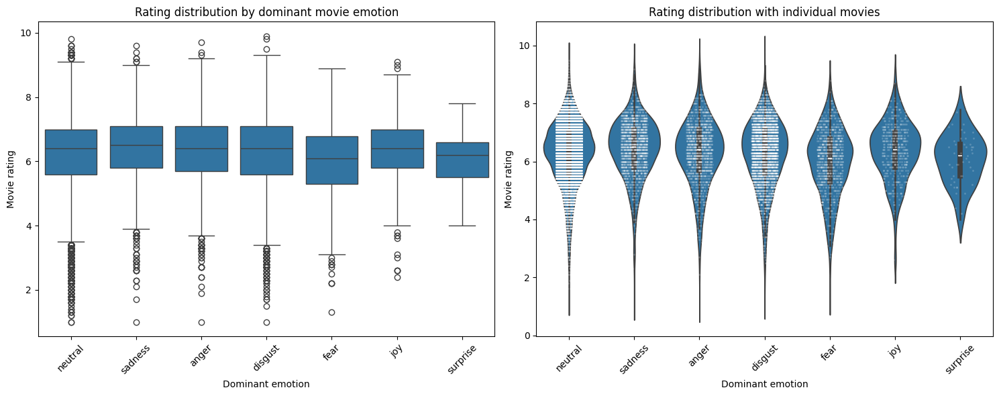

In [25]:
analysis_df, summary_stats, fig,  fig_mean_rating_dominant_emotion = run_dominant_emotion_analysis(df_emotion, df_metadata)
plt.show()
fig_mean_rating_dominant_emotion.show()

In [26]:
fig_mean_rating_dominant_emotion.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/mean_rating_per_dominant_emotion.html")

### Difference in mean rating according to dominant emotion for NA and Asia

In [34]:
def plot_continental_comparison(summary_stats_na, summary_stats_asia):
     
    # Create figure
    fig = go.Figure()
    
    # Create customdata arrays that include all the information we want to show
    na_customdata = np.column_stack((
        summary_stats_na['mean'].round(2),
        summary_stats_na['std'].round(2),
        summary_stats_na['count']
    ))
    
    asia_customdata = np.column_stack((
        summary_stats_asia['mean'].round(2),
        summary_stats_asia['std'].round(2),
        summary_stats_asia['count']
    ))
    
    # Add bars for North America
    fig.add_trace(go.Bar(
        name='North America',
        x=summary_stats_na.index,
        y=summary_stats_na['mean'],
        error_y=dict(
            type='data',
            array=summary_stats_na['std'],
            visible=True,
            color='rgba(0,0,0,0.5)',
            thickness=1.5,
            width=3
        ),
        marker_color='royalblue',
        opacity=0.7,
        customdata=na_customdata,
        hovertemplate="<b>North America - %{x}</b><br>" +
                      "Mean rating: %{customdata[0]:.2f}<br>" +
                      "Std Dev: %{customdata[1]:.2f}<br>" +
                      "Movies count: %{customdata[2]}<extra></extra>"
    ))
    
    # Add bars for Asia
    fig.add_trace(go.Bar(
        name='Asia',
        x=summary_stats_asia.index,
        y=summary_stats_asia['mean'],
        error_y=dict(
            type='data',
            array=summary_stats_asia['std'],
            visible=True,
            color='rgba(0,0,0,0.5)',
            thickness=1.5,
            width=3
        ),
        marker_color='lightcoral',
        opacity=0.7,
        customdata=asia_customdata,
        hovertemplate="<b>Asia - %{x}</b><br>" +
                      "Mean rating: %{customdata[0]:.2f}<br>" +
                      "Std Dev: %{customdata[1]:.2f}<br>" +
                      "Movies count: %{customdata[2]}<extra></extra>"
    ))
    
    # Update layout (same as before)
    fig.update_layout(
        title='Movie ratings by dominant emotion - continental comparison',
        xaxis_title='Dominant emotion',
        yaxis_title='Mean rating',
        barmode='group',
        yaxis_range=[4, 8],
        plot_bgcolor='#f0f0f8',
        paper_bgcolor='white',
        yaxis=dict(
            gridcolor='rgba(128,128,128,0.2)',
            gridwidth=1,
            griddash='dash'
        ),
        showlegend=True,
        legend=dict(
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1,
            orientation="h"
        )
    )
    
    return fig


Summary statistics by dominant emotion - North America:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger               575  6.14  1.07     6.2  1.9  9.7
disgust            1730  5.94  1.22     6.1  1.5  9.5
fear                489  5.75  1.20     5.8  1.3  8.6
joy                 167  6.15  0.96     6.3  2.4  8.1
neutral           11468  6.13  1.11     6.3  1.0  9.8
sadness             671  6.32  0.96     6.4  2.1  9.1
surprise             18  5.87  0.69     6.0  4.4  6.8

One-way ANOVA test results - North America:
F-statistic: 20.135
P-value: 0.000

Summary statistics by dominant emotion - Asia:
                  count  mean   std  median  min  max
dominant_emotion                                     
anger               461  6.39  1.31     6.6  1.0  9.4
disgust             884  6.47  1.19     6.6  2.4  9.8
fear                141  6.08  1.23     6.2  2.2  8.9
joy                 203  6.46  1.12     6.6  2.6  9.1
neutr

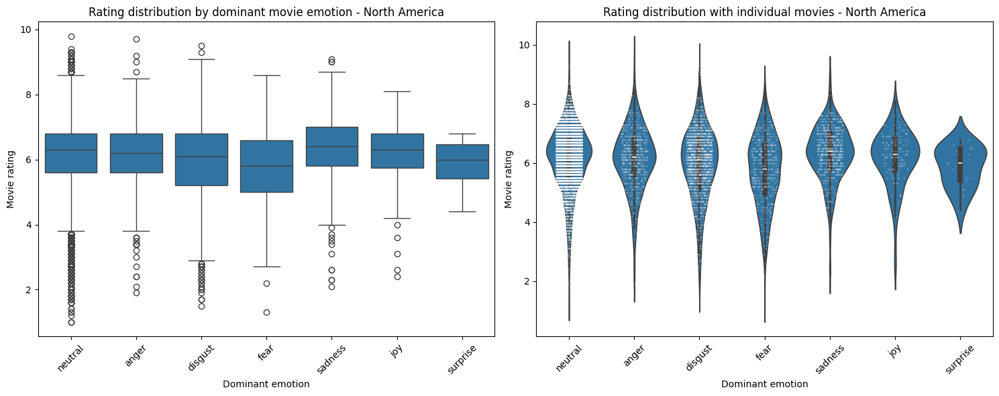

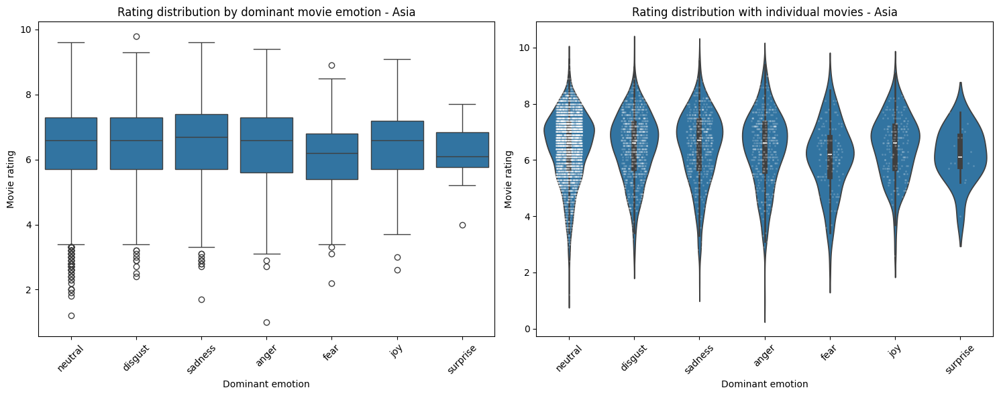

In [36]:
analysis_df_na, summary_stats_na, _, _ = run_dominant_emotion_analysis(emotions_NA, NA_films, "North America")
analysis_df_asia, summary_stats_asia, _, _ = run_dominant_emotion_analysis(emotions_Asia, Asia_films, "Asia")
fig = plot_continental_comparison(summary_stats_na, summary_stats_asia)
fig.show()
fig.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/figasiana.html")

## Mean rating per category, after exploding

In [37]:
def calculate_and_plot_mean_ratings(df_general):
    # Explode the categories into separate rows
    analysis_df = df_general[['Wikipedia_movie_ID', 'category', 'Rating']].explode('category')
    
    # Strip whitespace from categories if they're strings
    analysis_df['category'] = analysis_df['category'].apply(lambda x: x.strip() if isinstance(x, str) else x)
    
    # Calculate statistics by category
    stats_df = analysis_df.groupby('category').agg({
        'Wikipedia_movie_ID': 'count',
        'Rating': ['mean', 'std']
    }).reset_index()
    
    # Flatten column names and rename for clarity
    stats_df.columns = ['Category', 'Number of movies', 'Mean rating', 'Rating std']
    
    # Sort by mean rating in descending order
    stats_df = stats_df.sort_values('Mean rating', ascending=False)
    
    # Create color array based on categories
    bar_colors = [genre_colors.get(cat, '#808080') for cat in stats_df['Category']]
    
    # Create the interactive plot
    fig = go.Figure()
    
    # Add bar trace with error bars
    fig.add_trace(go.Bar(
        x=stats_df['Category'],
        y=stats_df['Mean rating'],
        text=stats_df['Mean rating'].round(2),
        textposition='inside',
        textfont=dict(
            size=14,
            color='black',
            weight='bold'
        ),
        marker_color=bar_colors,
        error_y=dict(
            type='data',
            array=stats_df['Rating std'],
            visible=True,
            color='rgba(30,30,30,0.3)',
            thickness=1.5,
            width=4
        ),
        hovertemplate=(
            "<b>%{x}</b><br>" +
            "Mean rating: %{y:.2f}<br>" +
            "Standard deviation: %{error_y.array:.2f}<br>" +
            "Number of movies: %{customdata:,}<br>" +
            "<extra></extra>"
        ),
        customdata=stats_df['Number of movies']
    ))
    
    # Update layout with better styling
    fig.update_layout(
        title={
            'text': 'Mean rating by movie category',
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': {'size': 24}
        },
        xaxis_title="Category",
        yaxis_title="Mean rating",
        yaxis_range=[
            stats_df['Mean rating'].min() - stats_df['Rating std'].max(),
            stats_df['Mean rating'].max() + stats_df['Rating std'].max() + 0.2
        ],
        showlegend=False,
        xaxis_tickangle=-45,
        hoverlabel=dict(
            bgcolor="white",
            font_size=14,
            font_family="Roboto"
        ),
        height=600,
        margin=dict(t=100, l=70, r=40, b=80),
        paper_bgcolor='white',
        plot_bgcolor='rgba(0,0,0,0)',
    )
    
    # Add grid lines only for y-axis
    fig.update_yaxes(
        showgrid=True,
        gridwidth=1,
        gridcolor='rgba(0,0,0,0.1)'
    )
    
    return fig, stats_df

In [38]:
fig, stats = calculate_and_plot_mean_ratings( df_metadata)
fig.show()

In [39]:
fig.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/mean_rating_by_category.html")

## K-Shape clustering

In [43]:
DATA_PATH_per_emotion_cluster = "data/emotions_cluster_assignments.pkl"  

df_per_emotions_cluster = pd.read_pickle(DATA_PATH_per_emotion_cluster)
df_per_emotions_cluster = df_per_emotions_cluster.reset_index(names=['Wikipedia_movie_ID'])

df_metadata_clusters = df_metadata.merge(
    df_per_emotions_cluster[['Wikipedia_movie_ID', 'anger', 'disgust', 'fear', 'joy', 'neutral', 'sadness', 'surprise']], 
    on='Wikipedia_movie_ID', 
    how='left'
)
df_metadata_clusters.head(2)

,Wikipedia_movie_ID,summary,Freebase_movie_ID,Movie_name,Movie_release_date,Movie_box_office_revenue,Movie_runtime,Movie_languages,Movie_countries,Movie_genres,category,continent,Rating,anger,disgust,fear,joy,neutral,sadness,surprise
0,3333,The film follows two juxtaposed families: the...,/m/0151l,The Birth of a Nation,NaN,50000000.0,190.0,"Silent film, English Language",United States of America,"Silent film, Indie, Costume drama, Epic, Black...","[Action/Adventure, Drama]",North America,6.1,1.0,0.0,1.0,0.0,0.0,1.0,1.0
1,3746,"In Los Angeles, November 2019, retired police...",/m/017n9,Blade Runner,1982.0,33139618.0,116.0,"Japanese Language, Cantonese, English Language...","United States of America, Hong Kong","Thriller, Cyberpunk, Science Fiction, Future n...","[Drama, Fantasy/Sci-Fi, Thriller]",North America,8.1,4.0,1.0,1.0,0.0,0.0,0.0,1.0


### Per emotion cluster ratings

In [ ]:
# List of all emotions
emotions_wo_neutral = ['anger', 'disgust', 'fear', 'joy', 'sadness', 'surprise']

# Loop through each emotion
for emotion in emotions_wo_neutral:
    print(f"\n{'='*50}")
    print(f"Analysis for {emotion.upper()}")
    print(f"{'='*50}")
    
    # 1. Create focused dataset
    emotion_rating_data = df_metadata_clusters[['Wikipedia_movie_ID', emotion, 'Rating']]
    
    # 2. Statistical summary
    cluster_stats = emotion_rating_data.groupby(emotion)['Rating'].describe()
    
    # 3. Collect ratings for each cluster
    cluster_groups = [group['Rating'].dropna().values 
                     for name, group in emotion_rating_data.groupby(emotion)]
    
    # 4. Perform ANOVA
    f_statistic, p_value = stats.f_oneway(*cluster_groups)
    
    # 5. Create boxplot
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=emotion_rating_data, x=emotion, y='Rating')
    plt.title(f'Movie ratings distribution by {emotion.capitalize()} cluster')
    plt.xlabel(f'{emotion.capitalize()} cluster')
    plt.ylabel('Rating')
    plt.show()
    
    # 6. Print results
    print("\nCount of movies in each cluster:")
    print(emotion_rating_data[emotion].value_counts().sort_index())
    
    print("\nStatistical summary by cluster:")
    print(cluster_stats)
    
    print(f"\nOne-way ANOVA results:")
    print(f"F-statistic: {f_statistic:.4f}")
    print(f"p-value: {p_value:.4f}")
    
    # Optional: add some visual separation between emotions
    print("\n\n")

    # No interesting results

### Explode categories, and for each per emotion cluster, divide for each category

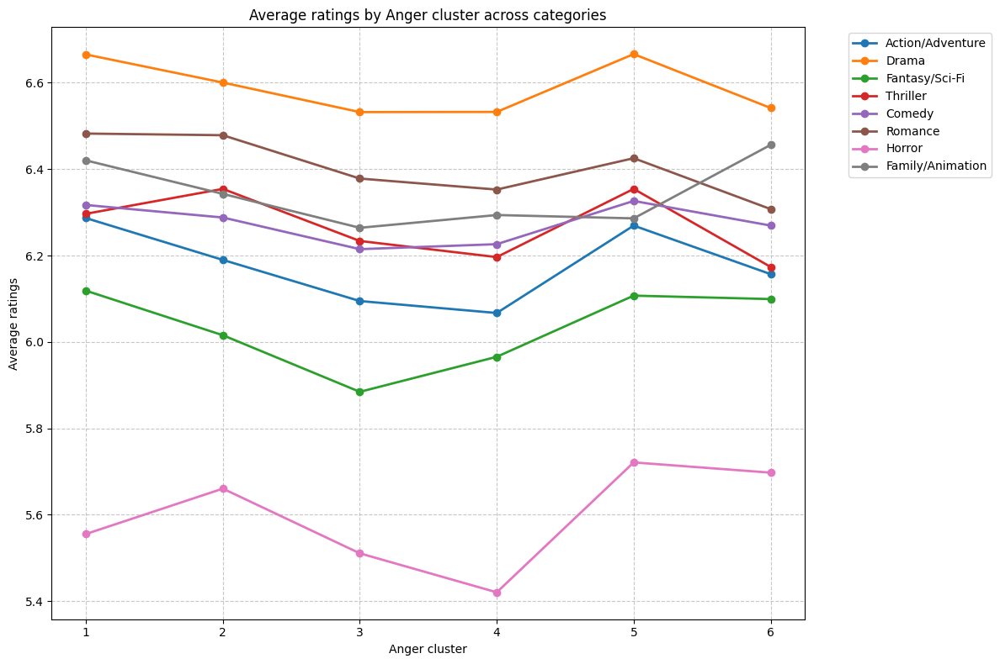

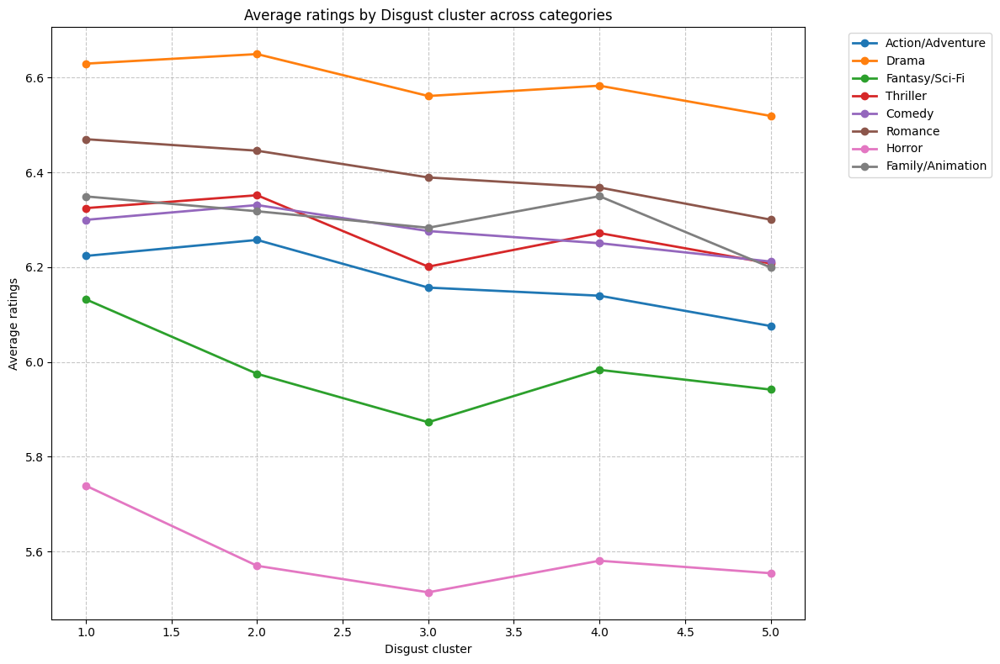

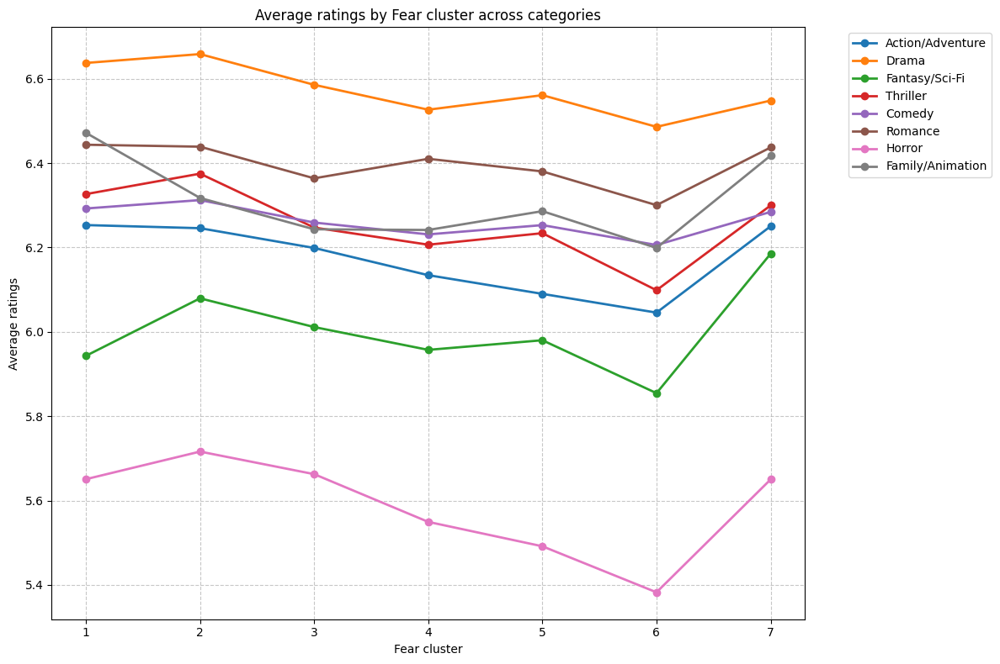

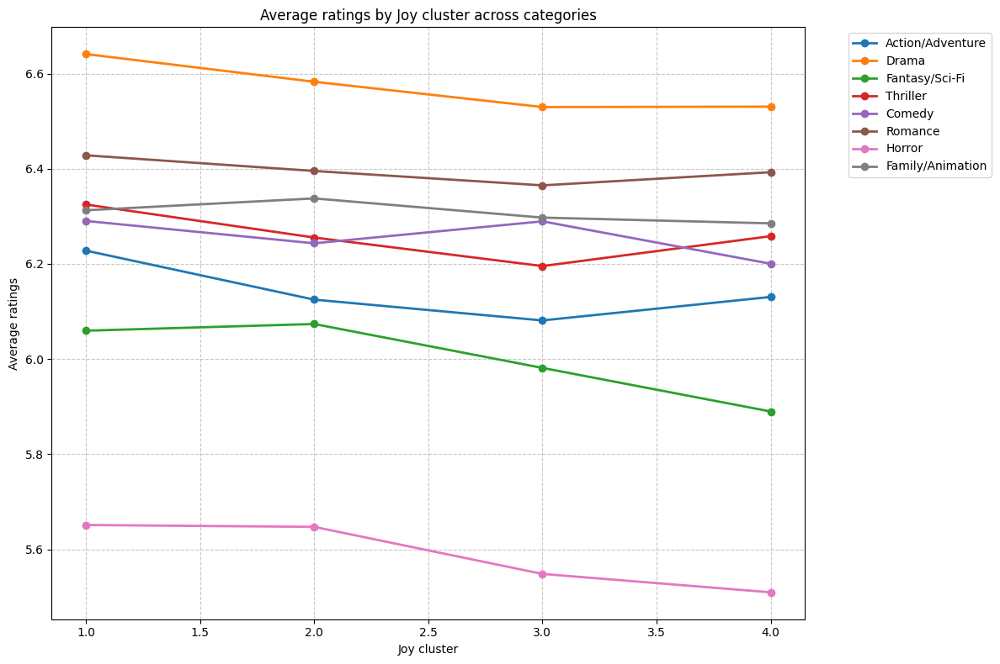

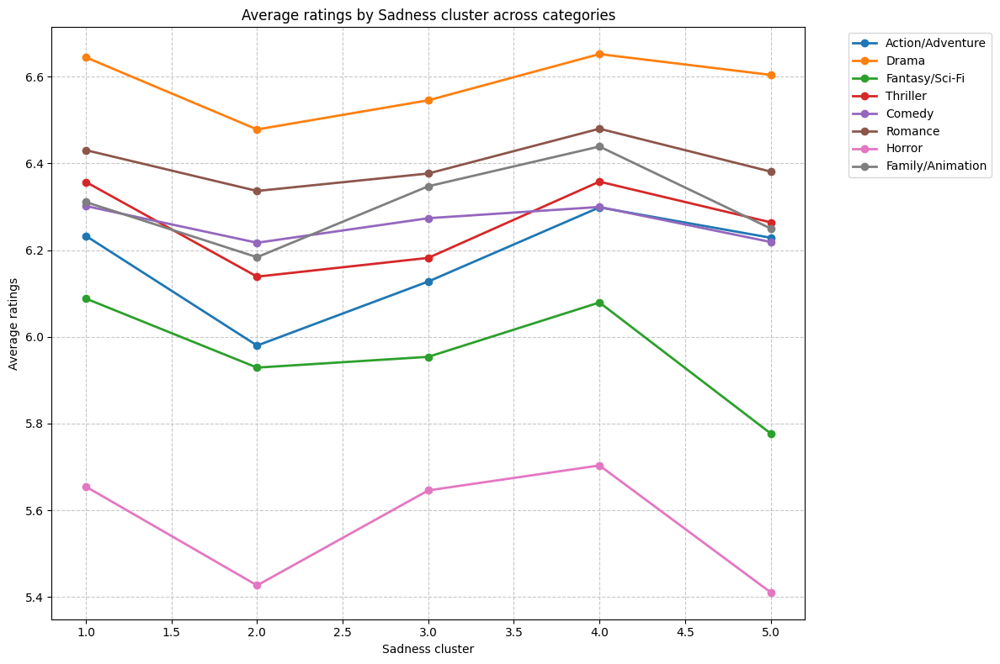

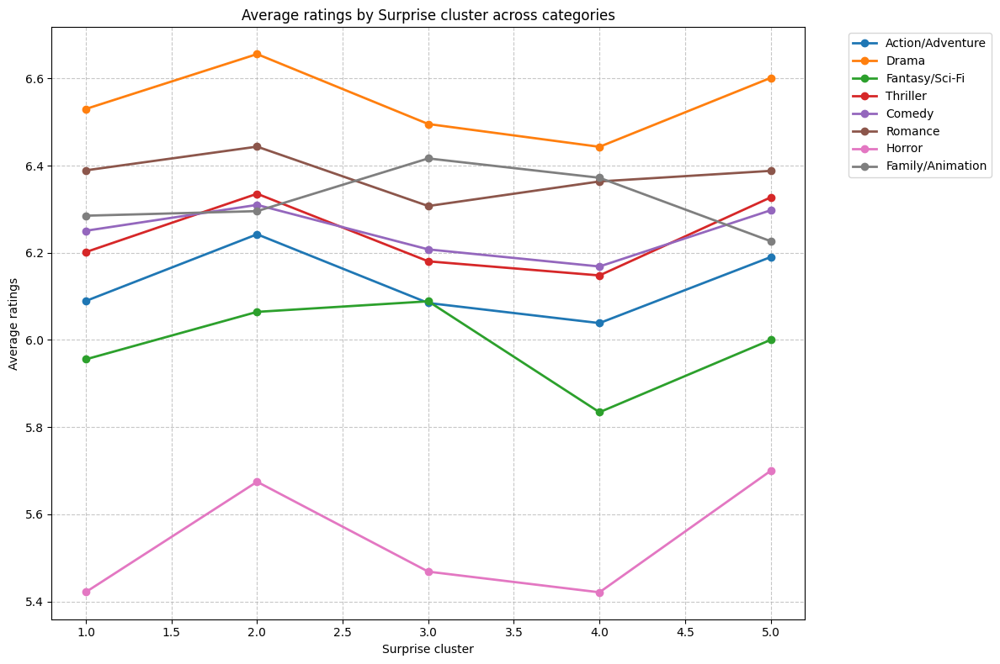

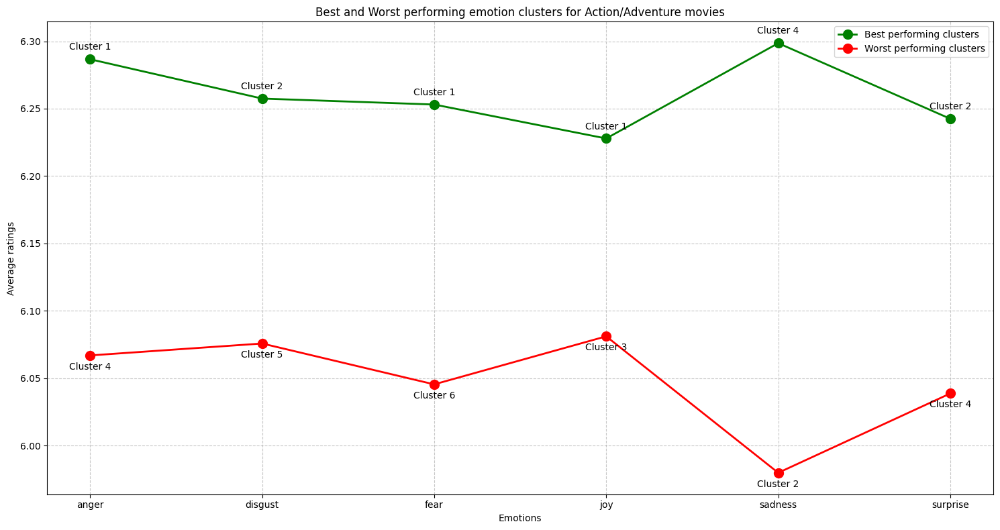


Summary for Action/Adventure:

Anger:
Best performing cluster: 1 (Rating: 6.29)
Worst performing cluster: 4 (Rating: 6.07)

Disgust:
Best performing cluster: 2 (Rating: 6.26)
Worst performing cluster: 5 (Rating: 6.08)

Fear:
Best performing cluster: 1 (Rating: 6.25)
Worst performing cluster: 6 (Rating: 6.05)

Joy:
Best performing cluster: 1 (Rating: 6.23)
Worst performing cluster: 3 (Rating: 6.08)

Sadness:
Best performing cluster: 4 (Rating: 6.30)
Worst performing cluster: 2 (Rating: 5.98)

Surprise:
Best performing cluster: 2 (Rating: 6.24)
Worst performing cluster: 4 (Rating: 6.04)


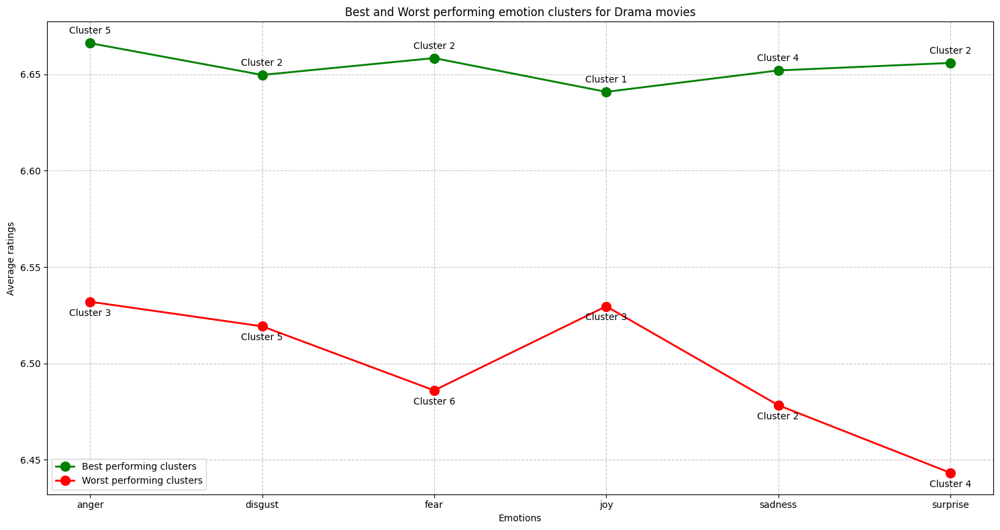


Summary for Drama:

Anger:
Best performing cluster: 5 (Rating: 6.67)
Worst performing cluster: 3 (Rating: 6.53)

Disgust:
Best performing cluster: 2 (Rating: 6.65)
Worst performing cluster: 5 (Rating: 6.52)

Fear:
Best performing cluster: 2 (Rating: 6.66)
Worst performing cluster: 6 (Rating: 6.49)

Joy:
Best performing cluster: 1 (Rating: 6.64)
Worst performing cluster: 3 (Rating: 6.53)

Sadness:
Best performing cluster: 4 (Rating: 6.65)
Worst performing cluster: 2 (Rating: 6.48)

Surprise:
Best performing cluster: 2 (Rating: 6.66)
Worst performing cluster: 4 (Rating: 6.44)


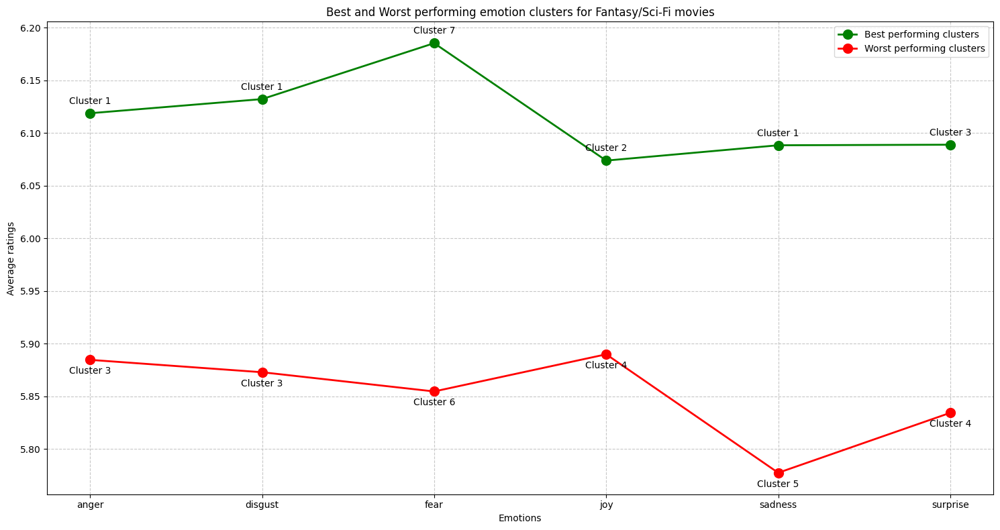


Summary for Fantasy/Sci-Fi:

Anger:
Best performing cluster: 1 (Rating: 6.12)
Worst performing cluster: 3 (Rating: 5.88)

Disgust:
Best performing cluster: 1 (Rating: 6.13)
Worst performing cluster: 3 (Rating: 5.87)

Fear:
Best performing cluster: 7 (Rating: 6.19)
Worst performing cluster: 6 (Rating: 5.85)

Joy:
Best performing cluster: 2 (Rating: 6.07)
Worst performing cluster: 4 (Rating: 5.89)

Sadness:
Best performing cluster: 1 (Rating: 6.09)
Worst performing cluster: 5 (Rating: 5.78)

Surprise:
Best performing cluster: 3 (Rating: 6.09)
Worst performing cluster: 4 (Rating: 5.83)


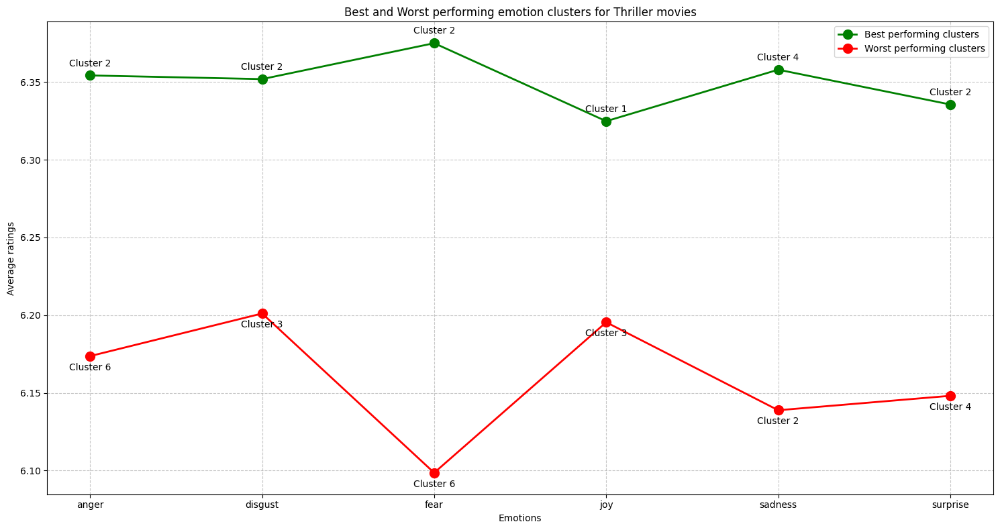


Summary for Thriller:

Anger:
Best performing cluster: 2 (Rating: 6.35)
Worst performing cluster: 6 (Rating: 6.17)

Disgust:
Best performing cluster: 2 (Rating: 6.35)
Worst performing cluster: 3 (Rating: 6.20)

Fear:
Best performing cluster: 2 (Rating: 6.37)
Worst performing cluster: 6 (Rating: 6.10)

Joy:
Best performing cluster: 1 (Rating: 6.32)
Worst performing cluster: 3 (Rating: 6.20)

Sadness:
Best performing cluster: 4 (Rating: 6.36)
Worst performing cluster: 2 (Rating: 6.14)

Surprise:
Best performing cluster: 2 (Rating: 6.34)
Worst performing cluster: 4 (Rating: 6.15)


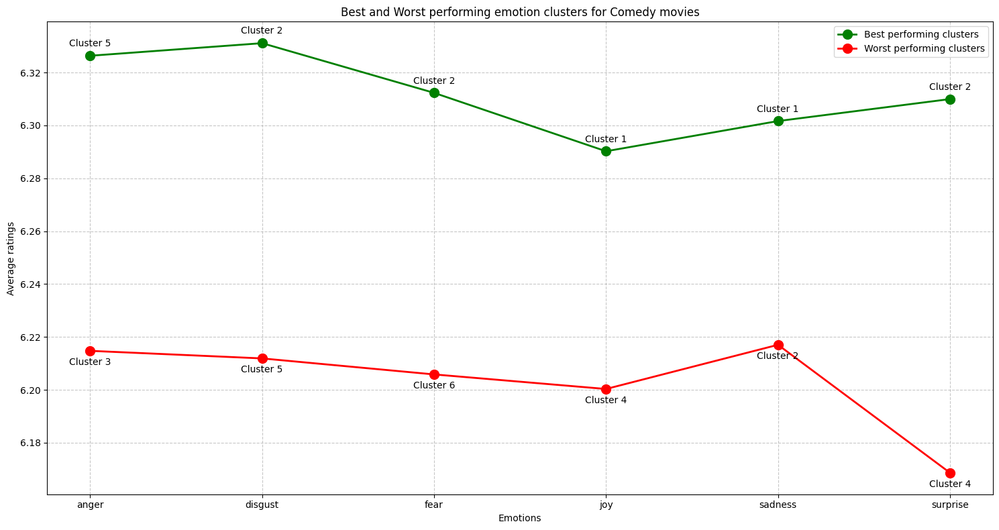


Summary for Comedy:

Anger:
Best performing cluster: 5 (Rating: 6.33)
Worst performing cluster: 3 (Rating: 6.21)

Disgust:
Best performing cluster: 2 (Rating: 6.33)
Worst performing cluster: 5 (Rating: 6.21)

Fear:
Best performing cluster: 2 (Rating: 6.31)
Worst performing cluster: 6 (Rating: 6.21)

Joy:
Best performing cluster: 1 (Rating: 6.29)
Worst performing cluster: 4 (Rating: 6.20)

Sadness:
Best performing cluster: 1 (Rating: 6.30)
Worst performing cluster: 2 (Rating: 6.22)

Surprise:
Best performing cluster: 2 (Rating: 6.31)
Worst performing cluster: 4 (Rating: 6.17)


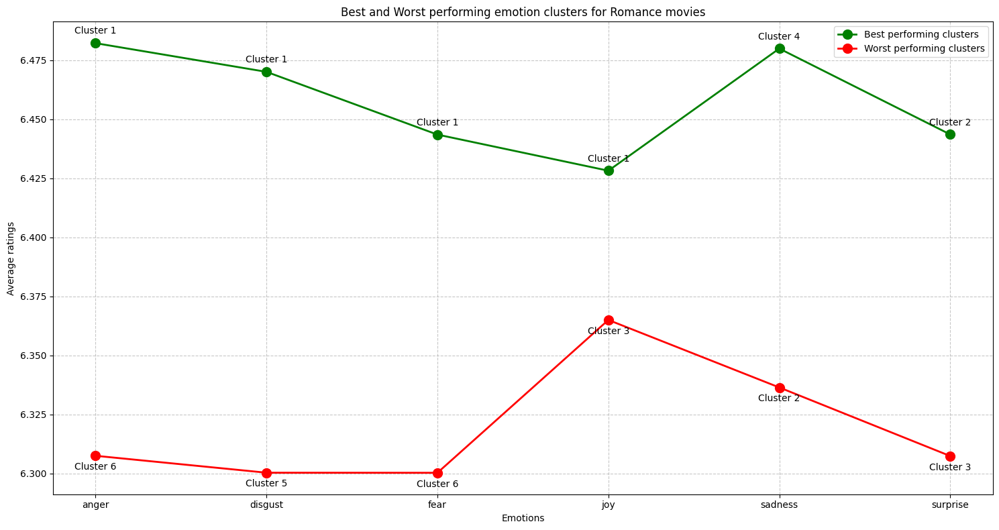


Summary for Romance:

Anger:
Best performing cluster: 1 (Rating: 6.48)
Worst performing cluster: 6 (Rating: 6.31)

Disgust:
Best performing cluster: 1 (Rating: 6.47)
Worst performing cluster: 5 (Rating: 6.30)

Fear:
Best performing cluster: 1 (Rating: 6.44)
Worst performing cluster: 6 (Rating: 6.30)

Joy:
Best performing cluster: 1 (Rating: 6.43)
Worst performing cluster: 3 (Rating: 6.37)

Sadness:
Best performing cluster: 4 (Rating: 6.48)
Worst performing cluster: 2 (Rating: 6.34)

Surprise:
Best performing cluster: 2 (Rating: 6.44)
Worst performing cluster: 3 (Rating: 6.31)


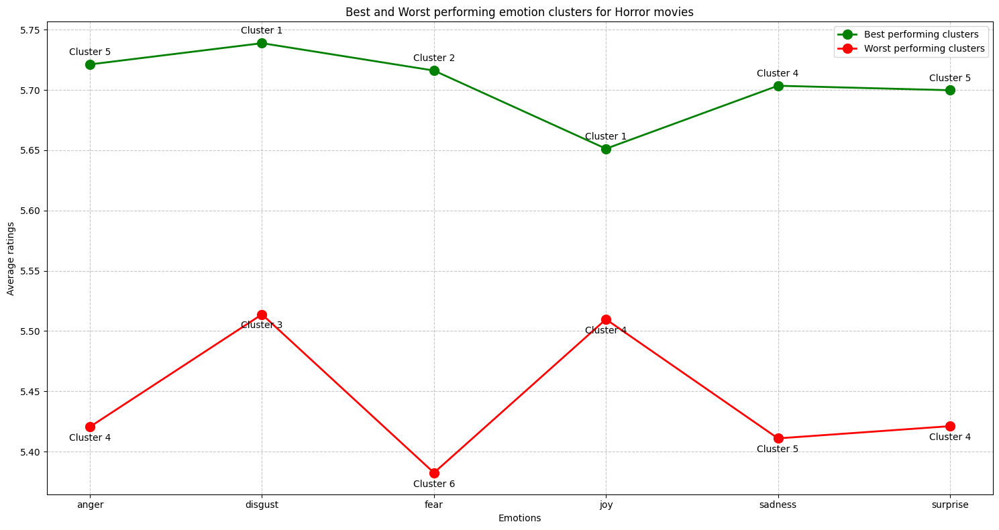


Summary for Horror:

Anger:
Best performing cluster: 5 (Rating: 5.72)
Worst performing cluster: 4 (Rating: 5.42)

Disgust:
Best performing cluster: 1 (Rating: 5.74)
Worst performing cluster: 3 (Rating: 5.51)

Fear:
Best performing cluster: 2 (Rating: 5.72)
Worst performing cluster: 6 (Rating: 5.38)

Joy:
Best performing cluster: 1 (Rating: 5.65)
Worst performing cluster: 4 (Rating: 5.51)

Sadness:
Best performing cluster: 4 (Rating: 5.70)
Worst performing cluster: 5 (Rating: 5.41)

Surprise:
Best performing cluster: 5 (Rating: 5.70)
Worst performing cluster: 4 (Rating: 5.42)


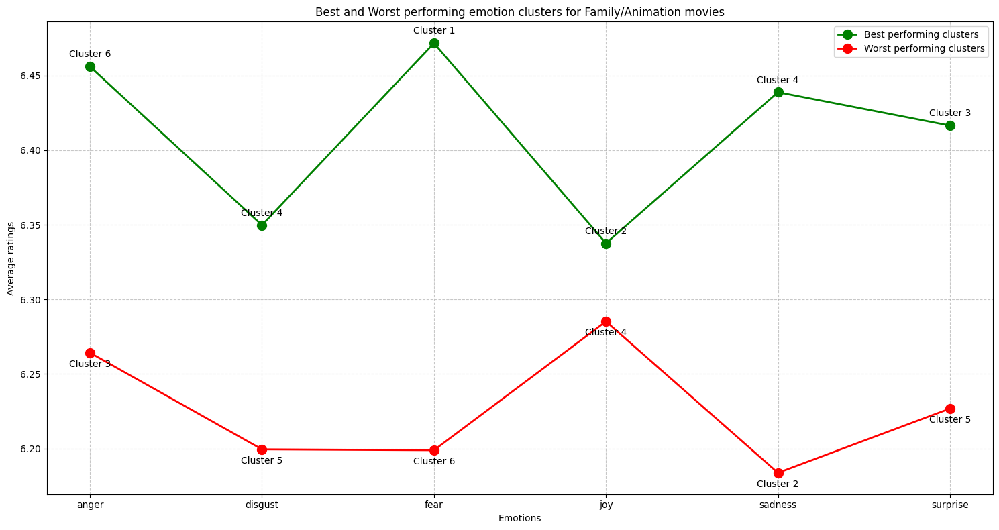


Summary for Family/Animation:

Anger:
Best performing cluster: 6 (Rating: 6.46)
Worst performing cluster: 3 (Rating: 6.26)

Disgust:
Best performing cluster: 4 (Rating: 6.35)
Worst performing cluster: 5 (Rating: 6.20)

Fear:
Best performing cluster: 1 (Rating: 6.47)
Worst performing cluster: 6 (Rating: 6.20)

Joy:
Best performing cluster: 2 (Rating: 6.34)
Worst performing cluster: 4 (Rating: 6.29)

Sadness:
Best performing cluster: 4 (Rating: 6.44)
Worst performing cluster: 2 (Rating: 6.18)

Surprise:
Best performing cluster: 3 (Rating: 6.42)
Worst performing cluster: 5 (Rating: 6.23)


In [51]:
# First, explode the dataset by category
df_exploded = df_metadata_clusters.explode('category')

# Get unique categories
categories = df_exploded['category'].unique()

for emotion in emotions_wo_neutral: 
    plt.figure(figsize=(12, 8))
    for category in categories:
        category_data = df_exploded[df_exploded['category'] == category]
        emotion_rating_data = category_data[['Wikipedia_movie_ID', emotion, 'Rating']]
        mean_ratings = emotion_rating_data.groupby(emotion)['Rating'].mean()
        plt.plot(mean_ratings.index+1, mean_ratings.values, marker='o', label=category, linewidth=2)
    
    plt.title(f'Average ratings by {emotion.capitalize()} cluster across categories')
    plt.xlabel(f'{emotion.capitalize()} cluster')
    plt.ylabel('Average ratings')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# New plots for best/worst clusters by category
for category in categories:
    plt.figure(figsize=(15, 8))
    
    # Filter data for this category
    category_data = df_exploded[df_exploded['category'] == category]
    
    # Store best and worst clusters for each emotion
    best_clusters = []
    worst_clusters = []
    best_ratings = []
    worst_ratings = []
    
    # For x-axis positioning
    x_positions = range(len(emotions_wo_neutral))
    
    for emotion in emotions_wo_neutral:
        # Get mean ratings for each cluster
        cluster_ratings = category_data.groupby(emotion)['Rating'].agg(['mean', 'count']).reset_index()
        # Only consider clusters with at least 5 movies
        cluster_ratings = cluster_ratings[cluster_ratings['count'] >= 5]
        
        if not cluster_ratings.empty:
            # Find best and worst clusters
            best_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmax()]
            worst_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmin()]

            # CHANGE 1: Add +1 to cluster numbers here
            best_clusters.append(f"{emotion}_{int(best_cluster[emotion] + 1)}")  # Added +1
            worst_clusters.append(f"{emotion}_{int(worst_cluster[emotion] + 1)}")  # Added +1
            
            best_ratings.append(best_cluster['mean'])
            worst_ratings.append(worst_cluster['mean'])
        else:
            best_clusters.append("N/A")
            worst_clusters.append("N/A")
            best_ratings.append(None)
            worst_ratings.append(None)
    
    # Plot
    plt.plot(x_positions, best_ratings, 'go-', label='Best performing clusters', linewidth=2, markersize=10)
    plt.plot(x_positions, worst_ratings, 'ro-', label='Worst performing clusters', linewidth=2, markersize=10)
    
    # Add cluster numbers as annotations
    for i, (best, worst) in enumerate(zip(best_clusters, worst_clusters)):
        if best != "N/A":
            plt.annotate(f'Cluster {best.split("_")[1]}', 
                        (i, best_ratings[i]), 
                        textcoords="offset points", 
                        xytext=(0,10), 
                        ha='center')
        if worst != "N/A":
            plt.annotate(f'Cluster {worst.split("_")[1]}', 
                        (i, worst_ratings[i]), 
                        textcoords="offset points", 
                        xytext=(0,-15), 
                        ha='center')
    
    plt.title(f'Best and Worst performing emotion clusters for {category} movies')
    plt.xlabel('Emotions')
    plt.ylabel('Average ratings')
    plt.xticks(x_positions, emotions_wo_neutral)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()
    
    # Add summary statistics
    print(f"\nSummary for {category}:")
    for emotion, best, worst in zip(emotions_wo_neutral, best_clusters, worst_clusters):
        if best != "N/A":
            print(f"\n{emotion.capitalize()}:")
            print(f"Best performing cluster: {best.split('_')[1]} (Rating: {best_ratings[emotions_wo_neutral.index(emotion)]:.2f})")
            print(f"Worst performing cluster: {worst.split('_')[1]} (Rating: {worst_ratings[emotions_wo_neutral.index(emotion)]:.2f})")
    

### Methods 

In [52]:
def safe_parse_mean_arc(mean_arc_value):
    # If it's a numpy array representation
    if isinstance(mean_arc_value, np.ndarray):
        return mean_arc_value.flatten().tolist()
    
    # If it's a string representation of numpy array
    if isinstance(mean_arc_value, str):
        try:
            # Try to evaluate the string as a numpy array
            parsed_array = np.array(eval(mean_arc_value))
            return parsed_array.flatten().tolist()
        except:
            # Fallback parsing methods
            try:
                # Remove array formatting and split
                cleaned = mean_arc_value.strip('array()[]')
                return [float(x.strip()) for x in cleaned.split(',') if x.strip()]
            except:
                raise ValueError(f"Could not parse mean arc value: {mean_arc_value}")
     

def plot_multi_movie_emotion_arc(
    df_emotion, 
    df_metadata_clusters, 
    mean_emotion_arcs, 
    wikipedia_movie_ids, 
    emotion,
):
    
    # Prepare traces for the plot
    traces = []
    
    # Keep track of used cluster IDs to avoid re-computing
    cluster_means = {}
    
    # Plot each movie's emotion arc
    for movie_id in wikipedia_movie_ids:
        # Filter the dataframe for the specific movie
        movie_emotion_data = df_emotion[df_emotion['Wikipedia_movie_ID'] == movie_id]
        
        # Skip if no emotion data for this movie
        if movie_emotion_data.empty:
            print(f"No emotion data found for movie ID {movie_id}")
            continue
        
        # Get the cluster ID for this movie for the specified emotion
        try:
            cluster_id = df_metadata_clusters[
                df_metadata_clusters['Wikipedia_movie_ID'] == movie_id
            ][emotion].values[0]
        except IndexError:
            print(f"No cluster information found for movie ID {movie_id}")
            continue
        
        # Movie emotion trace
        movie_trace = go.Scatter(
            x=movie_emotion_data['timestep'],
            y=movie_emotion_data[emotion],
            mode='lines+markers',
            name=f'Movie {movie_id} {emotion.capitalize()}',
            line=dict(
                width=2,
                dash='solid'
            ),
            marker=dict(
                size=6,
                opacity=0.7,
                symbol='circle'
            ),
            hovertemplate=f'Movie {movie_id} {emotion.capitalize()} emotion: %{{y:.4f}}<br>Timestep: %{{x}}<extra></extra>'
        )
        traces.append(movie_trace)
        
        # Compute or retrieve cluster mean (avoid recomputing for same cluster)
        if cluster_id not in cluster_means:
            # Cluster mean trace
            cluster_mean_data = mean_emotion_arcs[
                (mean_emotion_arcs['Emotion'] == emotion) & 
                (mean_emotion_arcs['cluster_id'] == cluster_id)
            ]
            
            if not cluster_mean_data.empty:
                # Parse the mean arc
                mean_arc = safe_parse_mean_arc(cluster_mean_data['mean_arc'].values[0])
                cluster_means[cluster_id] = mean_arc
            else:
                print(f"No cluster mean found for {emotion} in cluster {cluster_id}")
                continue
        
        # Add cluster mean trace (if computed)
        if cluster_id in cluster_means:
            mean_arc = cluster_means[cluster_id]
            cluster_trace = go.Scatter(
                x=list(range(len(mean_arc))),
                y=mean_arc,
                mode='lines+markers',
                name=f'Cluster {cluster_id} Mean',
                line=dict(
                    width=3,
                    dash='dot'
                ),
                marker=dict(
                    size=8,
                    symbol='diamond',
                    opacity=0.5
                ),
                hovertemplate=f'Cluster {cluster_id} mean {emotion.capitalize()}: %{{y:.4f}}<br>Timestep: %{{x}}<extra></extra>'
            )
            traces.append(cluster_trace)
    
    # Create the layout
    layout = go.Layout(
        title=f'{emotion.capitalize()} Emotion arcs for multiple movies vs cluster means',
        xaxis=dict(title='Timestep'),
        yaxis=dict(title=f'{emotion.capitalize()} emotion intensity'),
        hovermode='closest',
        legend_title_text='Movie emotion traces',
        template='plotly_white'
    )
    
    # Create Figure
    fig = go.Figure(data=traces, layout=layout)
    
    return fig

In [54]:
def plot_movie_emotion_arc_with_cluster_mean(
    df_emotion, 
    df_metadata_clusters, 
    mean_emotion_arcs, 
    wikipedia_movie_id, 
    emotion
):
    # Filter the dataframe for the specific movie
    movie_emotion_data = df_emotion[df_emotion['Wikipedia_movie_ID'] == wikipedia_movie_id]
    
    # Get the cluster ID for this movie for the specified emotion
    cluster_id = df_metadata_clusters[
        df_metadata_clusters['Wikipedia_movie_ID'] == wikipedia_movie_id
    ][emotion].values[0]

    # Get the movie name and rating
    movie_info = df_metadata_clusters[
        df_metadata_clusters['Wikipedia_movie_ID'] == wikipedia_movie_id
    ]
    movie_name = movie_info['Movie_name'].values[0]
    movie_rating = movie_info['Rating'].values[0]
    
    # Compute or retrieve cluster mean
    cluster_mean_data = mean_emotion_arcs[
        (mean_emotion_arcs['Emotion'] == emotion) & 
        (mean_emotion_arcs['cluster_id'] == cluster_id)
    ]
    
    # Parse the mean arc
    mean_arc = safe_parse_mean_arc(cluster_mean_data['mean_arc'].values[0])
    
    # Prepare traces for the plot
    traces = []
    
    # Movie emotion trace
    movie_trace = go.Scatter(
        x=movie_emotion_data['timestep'],
        y=movie_emotion_data[emotion],
        mode='lines+markers',
        name=f'{movie_name} {emotion.capitalize()} Emotion',
        line=dict(
            width=2,
            dash='solid'
        ),
        marker=dict(
            size=6,
            opacity=0.7,
            symbol='circle'
        ),
        hovertemplate=f'{movie_name} {emotion.capitalize()} emotion: %{{y:.4f}}<br>Timestep: %{{x}}<extra></extra>'
    )
    traces.append(movie_trace)
    
    # Cluster mean trace
    cluster_trace = go.Scatter(
        x=list(range(len(mean_arc))),
        y=mean_arc,
        mode='lines+markers',
        name=f'Cluster {cluster_id+1} Mean',
        line=dict(
            width=3,
            dash='dot'
        ),
        marker=dict(
            size=8,
            symbol='diamond',
            opacity=0.5
        ),
        hovertemplate=f'Cluster {cluster_id+1} mean {emotion.capitalize()}: %{{y:.4f}}<br>Timestep: %{{x}}<extra></extra>'
    )
    traces.append(cluster_trace)
    
    # Create the layout
    layout = go.Layout(
        title=f'{emotion.capitalize()} emotion arc of movie "{movie_name}" (Rating: {movie_rating}) against the mean emotion arc of {emotion} of cluster {cluster_id+1}',
        xaxis=dict(title='Timestep'),
        yaxis=dict(title=f'{emotion.capitalize()} emotion intensity'),
        annotations=[
            dict(
                xref='paper',
                yref='paper',
                x=1.0,
                y=1.05,
                text=f'Movie Rating: {movie_rating}',
                showarrow=False,
                font=dict(size=12)
            )
        ],
        hovermode='closest',
        legend_title_text='Emotion Traces',
        template='plotly_white'
    )
    
    # Create Figure
    fig = go.Figure(data=traces, layout=layout)
    
    return fig

In [55]:
def plot_interactive_categories_clusters(df_metadata_clusters):
    # First, explode the dataset by category
    df_exploded = df_metadata_clusters.explode('category')
    
    categories = sorted(df_exploded['category'].unique())
    
    # Default color for categories not in mapping
    default_color = '#999999'
    
    # Create figure with larger dimensions
    fig = go.Figure()
    
    for category in categories:
        # Get color for this category
        color = genre_colors.get(category, default_color)
        
        # Filter data for this category
        category_data = df_exploded[df_exploded['category'] == category]
        
        # Store best and worst clusters for each emotion
        best_ratings = []
        worst_ratings = []
        best_clusters = []
        worst_clusters = []
        
        for emotion in emotions_wo_neutral:
            # Get mean ratings for each cluster
            cluster_ratings = category_data.groupby(emotion)['Rating'].agg(['mean', 'count']).reset_index()
            # Only consider clusters with at least 5 movies
            cluster_ratings = cluster_ratings[cluster_ratings['count'] >= 5]
            
            if not cluster_ratings.empty:
                # Find best and worst clusters
                best_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmax()]
                worst_cluster = cluster_ratings.loc[cluster_ratings['mean'].idxmin()]
                
                best_clusters.append(int(best_cluster[emotion] + 1))
                worst_clusters.append(int(worst_cluster[emotion] + 1))
                best_ratings.append(best_cluster['mean'])
                worst_ratings.append(worst_cluster['mean'])
            else:
                best_clusters.append(None)
                worst_clusters.append(None)
                best_ratings.append(None)
                worst_ratings.append(None)
        
        # Create hover text for best and worst clusters
        best_hover_text = [f"Category: {category}<br>Emotion: {emotion}<br>Cluster: {cluster}<br>Rating: {rating:.2f}" 
                          for emotion, cluster, rating in zip(emotions_wo_neutral, best_clusters, best_ratings) 
                          if cluster is not None]
        worst_hover_text = [f"Category: {category}<br>Emotion: {emotion}<br>Cluster: {cluster}<br>Rating: {rating:.2f}" 
                           for emotion, cluster, rating in zip(emotions_wo_neutral, worst_clusters, worst_ratings) 
                           if cluster is not None]
        
        # Filter out None values for plotting
        x_best = [i for i, r in enumerate(best_ratings) if r is not None]
        y_best = [r for r in best_ratings if r is not None]
        x_worst = [i for i, r in enumerate(worst_ratings) if r is not None]
        y_worst = [r for r in worst_ratings if r is not None]
        
        # Add best clusters line
        fig.add_trace(
            go.Scatter(
                x=x_best,
                y=y_best,
                mode='lines+markers+text',
                name=category,
                line=dict(color=color, width=3),
                marker=dict(size=10, symbol='circle',
                          line=dict(color='white', width=1)),
                text=[str(c) for c in best_clusters if c is not None],
                textposition="top center",
                hovertext=best_hover_text,
                hoverinfo='text',
                visible=True,
                legendgroup=category,
                showlegend=True
            )
        )
        
        # Add worst clusters line
        fig.add_trace(
            go.Scatter(
                x=x_worst,
                y=y_worst,
                mode='lines+markers+text',
                name=category,  # Use same name as best line
                line=dict(color=color, width=3, dash='dash'),
                marker=dict(size=10, symbol='square',
                          line=dict(color='white', width=1)),
                text=[str(c) for c in worst_clusters if c is not None],
                textposition="bottom center",
                hovertext=worst_hover_text,
                hoverinfo='text',
                visible=True,
                legendgroup=category,
                showlegend=False  # Don't show in legend
            )
        )

    # Update layout
    fig.update_layout(
        # Increase figure size
        width=1000,
        height=1400,
        
        title={
            'text': 'Best and Worst performing emotion clusters across categories',
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': dict(size=16)
        },
        xaxis=dict(
            ticktext=[e.capitalize() for e in emotions_wo_neutral],
            tickvals=list(range(len(emotions_wo_neutral))),
            title='Emotions',
            titlefont=dict(size=12),
            gridcolor='rgba(128,128,128,0.2)',
            showgrid=True,
        ),
        yaxis=dict(
            title='Average rating',
            titlefont=dict(size=12),
            gridcolor='rgba(128,128,128,0.2)',
            showgrid=True,
            range=[5.25, 6.8]  # Set fixed range for y-axis
        ),
        plot_bgcolor='white',
        hovermode='closest',
        legend=dict(
            yanchor="top",
            y=1,
            xanchor="left",
            x=1.02,
            font=dict(size=10),
            bordercolor="Black",
            borderwidth=1,
            itemsizing='constant',
            itemclick='toggle'  # Change to regular toggle
        ),
        # Add more right margin to ensure legend fits
        margin=dict(r=300)
    )
    
    # Add grid
    fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='rgba(128,128,128,0.2)')
    fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='rgba(128,128,128,0.2)')
    
    return fig

In [56]:
def correlation_similarity(film_arc, mean_arc):
    # Normalize both arcs
    film_arc_normalized =  (film_arc - film_arc.mean()) / film_arc.std()
    mean_arc_normalized = (mean_arc - mean_arc.mean()) / mean_arc.std()

    # Calculate correlation
    correlation = np.corrcoef(film_arc_normalized, mean_arc_normalized)[0, 1]
    
    # Convert to distance (0 at perfect correlation)
    return 1 - abs(correlation)

def derivative_similarity(film_arc, mean_arc):
    # Normalize both arcs
    film_arc_normalized =  (film_arc - film_arc.mean()) / film_arc.std()
    mean_arc_normalized = (mean_arc - mean_arc.mean()) / mean_arc.std()

    # Calculate first derivatives
    film_deriv = np.gradient(film_arc_normalized)
    mean_deriv = np.gradient(mean_arc_normalized)
    
    # Calculate Euclidean distance between derivatives
    return np.linalg.norm(film_deriv - mean_deriv)

def peak_similarity(film_arc, mean_arc):
    # Normalize both arcs
    film_arc_normalized =  (film_arc - film_arc.mean()) / film_arc.std()
    mean_arc_normalized = (mean_arc - mean_arc.mean()) / mean_arc.std()
    
    # Find peak indices and values
    film_peak_index = np.argmax(film_arc_normalized)
    mean_peak_index = np.argmax(mean_arc_normalized)
    
    # Peak index distance (normalized by arc length)
    peak_index_dist = abs(film_peak_index - mean_peak_index) / len(film_arc_normalized)
    
    # Peak value difference
    film_peak_value = np.max(film_arc_normalized)
    mean_peak_value = np.max(mean_arc_normalized)
    peak_value_dist = abs(film_peak_value - mean_peak_value)
    
    # Combine peak index and value distances
    return (peak_index_dist + peak_value_dist) / 2

def curve_shape_distance(film_arc, mean_arc):
    # Calculate individual similarity components
    correlation_dist = correlation_similarity(film_arc, mean_arc)
    deriv_dist = derivative_similarity(film_arc, mean_arc)
    peak_dist = peak_similarity(film_arc, mean_arc)
    
    # Weighted combination of similarities
    # Weights chosen to balance different aspects of curve shape
    total_distance = (
        0.4 * correlation_dist +  # Overall shape similarity
        0.3 * deriv_dist +        # Rate of change similarity
        0.3 * peak_dist           # Peak characteristics
    )
    
    return total_distance

def find_top_10_closest_films(
    mean_emotion_arcs,
    df_emotion,
    df_metadata_clusters,
    emotion,
    cluster_id,
    genre=None
):
     
    # Explode category to handle multi-category films
    df_metadata_clusters = df_metadata_clusters.explode('category')

    # Extract the mean emotion arc for the given emotion and cluster ID
    mean_arc_df = mean_emotion_arcs.loc[
        (mean_emotion_arcs['Emotion'] == emotion) & 
        (mean_emotion_arcs['cluster_id'] == cluster_id), 
        'mean_arc'
    ]

    if mean_arc_df.empty:
        print(f"No matching mean emotion arc found for emotion '{emotion}' and cluster ID {cluster_id}")
        return None

    # Safely parse mean arc (handles different input formats)
    mean_arc = np.array(mean_arc_df.values[0]).flatten()

    # Filter the films that belong to the specified cluster ID for the given emotion
    filtered_films = df_metadata_clusters[
        df_metadata_clusters[emotion] == cluster_id
    ].copy()

    if filtered_films.empty:
        print(f"No films found for emotion '{emotion}' and cluster ID {cluster_id}")
        return None

    # Genre filtering if specified
    if genre:
        # Convert genre to lowercase for case-insensitive matching
        genre = genre.lower()

        # Filter films that have the specified genre
        filtered_films = filtered_films[
            filtered_films['category'].str.lower().str.contains(genre, na=False)
        ]

        if filtered_films.empty:
            print(f"No films found for emotion '{emotion}', cluster ID {cluster_id}, and genre '{genre}'")
            return None

    # Calculate the distance between each film's emotion arc and the mean emotion arc
    distances = []
    for _, row in filtered_films.iterrows():
        movie_id = row['Wikipedia_movie_ID']

        # Ensure the film's emotion arc exists in df_emotion
        film_arc_series = df_emotion[df_emotion['Wikipedia_movie_ID'] == movie_id]

        if film_arc_series.empty:
            distances.append(np.inf)  # Skip films without emotion arc
            continue

        film_arc = film_arc_series[emotion].values
        
        # Calculate curve shape distance
        distance = curve_shape_distance(film_arc, mean_arc)
        distances.append(distance)

    # Add distances to the DataFrame
    filtered_films['distance'] = distances

    # Remove any rows with infinite distance (films without emotion arc)
    filtered_films = filtered_films[filtered_films['distance'] != np.inf]

    # Check if any films remain after filtering
    if filtered_films.empty:
        print("No films found after filtering and distance calculation")
        return None

    # Sort films by distance (ascending) and then by Rating (descending)
    top_10_closest_films = filtered_films.sort_values(
        by=['distance', 'Rating'],
        ascending=[True, False]
    ).head(10)

    # Prepare return dictionary
    return {
        'details': top_10_closest_films[['Wikipedia_movie_ID', 'Movie_name', 'category', 'Rating', 'distance']],
        'wikipedia_movie_ids': top_10_closest_films['Wikipedia_movie_ID'].tolist()
    }


### "Which clusters have the highest average ratings?"
Calculates the mean rating for each emotion cluster directly. 
Identifies the "best" cluster as the one with the highest average rating (requiring at least 5 movies).
Compares all movies in a cluster, not just top-rated ones.
Output shows which clusters achieve the highest average ratings overall.

In [57]:
fig_best_and_worst_clusters = plot_interactive_categories_clusters(df_metadata_clusters)
fig_best_and_worst_clusters.show()

In [58]:
fig_best_and_worst_clusters.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/best_and_worst_clusters_general.html")

In [59]:
def print_cluster_performance_stats(df_metadata_clusters):
    # First, explode the dataset by category
    df_exploded = df_metadata_clusters.explode('category')
    
    # Get unique categories
    categories = df_exploded['category'].unique()
    
    # Dictionary to store results for each emotion and cluster
    cluster_stats = {}
    
    # For each emotion, find which categories have it as best/worst
    for emotion in emotions_wo_neutral:
        cluster_stats[emotion] = {}
        
        # Find the range of clusters for this emotion
        min_cluster = int(df_metadata_clusters[emotion].min())
        max_cluster = int(df_metadata_clusters[emotion].max())
        
        # Initialize stats for each cluster
        for cluster in range(min_cluster, max_cluster + 1):
            cluster_stats[emotion][cluster] = {
                'best_for': [],
                'worst_for': [],
                'rating_diffs': {}  # New dictionary to store rating differences
            }
        
        # Go through each category and find best/worst clusters
        for category in categories:
            category_data = df_exploded[df_exploded['category'] == category]
            
            # Get mean ratings for each cluster
            cluster_ratings = category_data.groupby(emotion)['Rating'].agg(['mean', 'count']).reset_index()
            # Only consider clusters with at least 5 movies
            cluster_ratings = cluster_ratings[cluster_ratings['count'] >= 5]
            
            if not cluster_ratings.empty:
                # Find best and worst clusters and their ratings
                best_row = cluster_ratings.loc[cluster_ratings['mean'].idxmax()]
                worst_row = cluster_ratings.loc[cluster_ratings['mean'].idxmin()]
                
                best_cluster = int(best_row[emotion])
                worst_cluster = int(worst_row[emotion])
                
                # Calculate rating difference
                rating_diff = best_row['mean'] - worst_row['mean']
                
                # Store the results
                cluster_stats[emotion][best_cluster]['best_for'].append(category)
                cluster_stats[emotion][best_cluster]['rating_diffs'][category] = rating_diff
                
                cluster_stats[emotion][worst_cluster]['worst_for'].append(category)
                cluster_stats[emotion][worst_cluster]['rating_diffs'][category] = rating_diff
    
    # Print the results in a formatted way
    for emotion in emotions_wo_neutral:
        print(f"\n{emotion.upper()}")
        print("=" * 50)
        
        for cluster in sorted(cluster_stats[emotion].keys()):
            stats = cluster_stats[emotion][cluster]
            cluster_number = cluster + 1  # Add 1 to match the displayed cluster numbers
            
            if stats['best_for'] or stats['worst_for']:  # Only print if cluster has any stats
                print(f"\nCluster {cluster_number}:")
                
                if stats['best_for']:
                    best_categories = [f"{cat} (Δ: {stats['rating_diffs'][cat]:.2f})" 
                                     for cat in stats['best_for']]
                    print(f"  Best for: {', '.join(best_categories)}")
                
                if stats['worst_for']:
                    worst_categories = [f"{cat} (Δ: {stats['rating_diffs'][cat]:.2f})" 
                                      for cat in stats['worst_for']]
                    print(f"  Worst for: {', '.join(worst_categories)}")

    return cluster_stats  # Return the dictionary for potential further use

In [60]:
stats = print_cluster_performance_stats(df_metadata_clusters)


ANGER

Cluster 1:
  Best for: Action/Adventure (Δ: 0.22), Fantasy/Sci-Fi (Δ: 0.23), Romance (Δ: 0.17)

Cluster 2:
  Best for: Thriller (Δ: 0.18)

Cluster 3:
  Worst for: Drama (Δ: 0.13), Fantasy/Sci-Fi (Δ: 0.23), Comedy (Δ: 0.11), Family/Animation (Δ: 0.19)

Cluster 4:
  Worst for: Action/Adventure (Δ: 0.22), Horror (Δ: 0.30)

Cluster 5:
  Best for: Drama (Δ: 0.13), Comedy (Δ: 0.11), Horror (Δ: 0.30)

Cluster 6:
  Best for: Family/Animation (Δ: 0.19)
  Worst for: Thriller (Δ: 0.18), Romance (Δ: 0.17)

DISGUST

Cluster 1:
  Best for: Fantasy/Sci-Fi (Δ: 0.26), Romance (Δ: 0.17), Horror (Δ: 0.22)

Cluster 2:
  Best for: Action/Adventure (Δ: 0.18), Drama (Δ: 0.13), Thriller (Δ: 0.15), Comedy (Δ: 0.12)

Cluster 3:
  Worst for: Fantasy/Sci-Fi (Δ: 0.26), Thriller (Δ: 0.15), Horror (Δ: 0.22)

Cluster 4:
  Best for: Family/Animation (Δ: 0.15)

Cluster 5:
  Worst for: Action/Adventure (Δ: 0.18), Drama (Δ: 0.13), Comedy (Δ: 0.12), Romance (Δ: 0.17), Family/Animation (Δ: 0.15)

FEAR

Cluster 1:
 

### Examples of movies from best-performing cluster per emotion per movie category for data story

In [65]:
top_10_drama_cluster1_joy = find_top_10_closest_films(
    df_mean_emotion_arcs_k_cluster, 
    df_emotion, 
    df_metadata_clusters, 
    emotion='joy', 
    cluster_id=0,
    genre='Drama'
)
print(top_10_drama_cluster1_joy['details'])

wikipedia_movie_ids_top_10_drama_cluster1_joy = top_10_drama_cluster1_joy['wikipedia_movie_ids']

       Wikipedia_movie_ID                   Movie_name category  Rating  \
12570             6557991                      Dushman    Drama     6.8   
22922            18430337               The Love Light    Drama     6.4   
32165            31727546             The First Grader    Drama     7.4   
9270              4147193                  Extremities    Drama     6.3   
4243              1571097                       Eragon    Drama     5.1   
12884             6809403               Unnai Ninaithu    Drama     7.2   
10038             4692894                   Marupakkam    Drama     7.1   
6576              2576435         Ring of Bright Water    Drama     7.1   
21789            16653876  Return to Two Moon Junction    Drama     3.9   
8948              3917891       The King and the Clown    Drama     6.8   

       distance  
12570  0.167918  
22922  0.172714  
32165  0.193699  
9270   0.215139  
4243   0.220957  
12884  0.235531  
10038  0.248016  
6576   0.274541  
21789  0.286

In [66]:
top_10_drama_cluster1_joy_plot = plot_multi_movie_emotion_arc(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_ids_top_10_drama_cluster1_joy,
    'joy'
)

top_10_drama_cluster1_joy_plot.show()

In [317]:
# Plot joy emotion arc for a specific movie
fig_drama_movie_joy_cluster1= plot_movie_emotion_arc_with_cluster_mean(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_id=31727546,
    emotion='joy'
)
fig_drama_movie_joy_cluster1.show()
fig_drama_movie_joy_cluster1.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/fig_drama_movie_joy_cluster1.html")

In [318]:
top_10_thriller_cluster6_fear = find_top_10_closest_films(
    df_mean_emotion_arcs_k_cluster, 
    df_emotion, 
    df_metadata_clusters, 
    emotion='fear', 
    cluster_id=5,
    genre='Thriller'
)
print(top_10_thriller_cluster6_fear['details'])

wikipedia_movie_ids_top_10_thriller_cluster6_fear= top_10_thriller_cluster6_fear['wikipedia_movie_ids']

       Wikipedia_movie_ID                     Movie_name  category  Rating  \
7185              2911536  Nella stretta morsa del ragno  Thriller     5.5   
16941            10659905                 Are You Scared  Thriller     NaN   
8443              3648919                  Today You Die  Thriller     NaN   
27764            24643389                  Katalin Varga  Thriller     7.0   
28252            25397721                 5150 Elm's Way  Thriller     6.5   
12597             6575394              Lords of the Deep  Thriller     2.7   
11894             5996219         Murder at the Vanities  Thriller     6.5   
19721            13687674   Chocolate: Deep Dark Secrets  Thriller     4.8   
29500            26846103           The Franchise Affair  Thriller     7.1   
9520              4316412                 Final Analysis  Thriller     5.9   

       distance  
7185   0.422092  
16941  0.469016  
8443   0.573691  
27764  0.580486  
28252  0.582977  
12597  0.642498  
11894  0.645386

In [325]:
# Plot joy emotion arc for a specific movie
fig_thriller_fear_cluster6= plot_movie_emotion_arc_with_cluster_mean(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_id=2911536,
    emotion='fear'
)
fig_thriller_fear_cluster6.show()
fig_thriller_fear_cluster6.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/fig_thriller_fear_cluster6.html")

In [326]:
top_10_family_surprise_cluster3 = find_top_10_closest_films(
    df_mean_emotion_arcs_k_cluster, 
    df_emotion, 
    df_metadata_clusters, 
    emotion='surprise', 
    cluster_id=2,
    genre='Family/Animation'
)
print(top_10_family_surprise_cluster3['details'])

wikipedia_movie_ids_top_10_family_surprise_cluster3= top_10_family_surprise_cluster3['wikipedia_movie_ids']

       Wikipedia_movie_ID                Movie_name          category  Rating  \
1410               357478          The Band Concert  Family/Animation     8.1   
30029            27754332         Sammy Going South  Family/Animation     7.1   
14698             8563102           Rooty Toot Toot  Family/Animation     5.0   
26570            23299382  The Legend of Gator Face  Family/Animation     4.8   
21913            16858560                    Comedy  Family/Animation     7.8   
5927              2303104       Herbie Goes Bananas  Family/Animation     4.9   
17167            10844342             The Dog House  Family/Animation     4.1   
33955            35887731       The Longest Daycare  Family/Animation     7.7   
20747            14873897              Nim's Island  Family/Animation     6.0   
18039            11720878                   Sailaab  Family/Animation     5.0   

       distance  
1410   1.160223  
30029  1.163083  
14698  1.175479  
26570  1.236101  
21913  1.240564  


In [332]:
top_10_family_surprise_cluster3_plot = plot_multi_movie_emotion_arc(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    #wikipedia_movie_ids_top_10_family_surprise_cluster3,
    [357478],
    'surprise'
)
top_10_family_surprise_cluster3_plot.show()

In [333]:
# Plot joy emotion arc for a specific movie
fig_family_surprise_cluster3= plot_movie_emotion_arc_with_cluster_mean(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_id=357478,
    emotion='surprise'
)
fig_family_surprise_cluster3.show()
fig_family_surprise_cluster3.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/fig_family_surprise_cluster3.html")

In [361]:
top_10_disgust_cluster3_fantasy = find_top_10_closest_films(
    df_mean_emotion_arcs_k_cluster, 
    df_emotion, 
    df_metadata_clusters, 
    emotion='disgust', 
    cluster_id=2,
    genre='Fantasy/Sci-Fi'
)
print(top_10_disgust_cluster3_fantasy['details'])

wikipedia_movie_ids_top_10_disgust_cluster3_fantasy= top_10_disgust_cluster3_fantasy['wikipedia_movie_ids']

       Wikipedia_movie_ID                      Movie_name        category  \
10145             4785986                         Bedhead  Fantasy/Sci-Fi   
13550             7420154              Le Roi et l'oiseau  Fantasy/Sci-Fi   
340                 73842             Gertie the Dinosaur  Fantasy/Sci-Fi   
32607            32818732                     Holy Motors  Fantasy/Sci-Fi   
33528            34970809  Painted Skin: The Resurrection  Fantasy/Sci-Fi   
14694             8560225                          Harpya  Fantasy/Sci-Fi   
17905            11582801           Children of the Night  Fantasy/Sci-Fi   
8931              3906643             The Corpse Vanishes  Fantasy/Sci-Fi   
30912            29053279              Afraid of the Dark  Fantasy/Sci-Fi   
14832             8675614                    Leprechaun 2  Fantasy/Sci-Fi   

       Rating  distance  
10145     5.4  0.714997  
13550     7.7  0.731105  
340       NaN  0.786666  
32607     7.0  0.847162  
33528     6.2  0.85525

In [362]:
# Plot joy emotion arc for a specific movie
fig_fantasy_disgust_cluster3= plot_movie_emotion_arc_with_cluster_mean(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_id=4785986,
    emotion='disgust'
)
fig_fantasy_disgust_cluster3.show()
fig_fantasy_disgust_cluster3.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/fig_fantasy_disgust_cluster3.html")

In [367]:
top_10_sadness_cluster4_action = find_top_10_closest_films(
    df_mean_emotion_arcs_k_cluster, 
    df_emotion, 
    df_metadata_clusters, 
    emotion='sadness', 
    cluster_id=3,
    genre='Action/Adventure'
)
print(top_10_sadness_cluster4_action['details'])

wikipedia_movie_ids_top_10_sadness_cluster4_action= top_10_sadness_cluster4_action['wikipedia_movie_ids']

       Wikipedia_movie_ID                                 Movie_name  \
24527            20388612                        The Secret Invasion   
29283            26588532                                     Ustaad   
4880              1850269                  Kekexili: Mountain Patrol   
31638            30875502                         Jumpin' Jack Flash   
25919            22277632                 Transmorphers: Fall of Man   
8581              3720859                          The Wrecking Crew   
30322            28157443                             The Wild North   
9014              3957383  The Land Before Time VIII: The Big Freeze   
2312               703970                                   Anaconda   
26429            23093539                     The Man from Hong Kong   

               category  Rating  distance  
24527  Action/Adventure     5.8  0.923687  
29283  Action/Adventure     5.5  1.019283  
4880   Action/Adventure     7.6  1.031655  
31638  Action/Adventure     5.9

In [378]:
fig_action_sadness_cluster4= plot_movie_emotion_arc_with_cluster_mean(
    df_emotion,
    df_metadata_clusters,
    df_mean_emotion_arcs_k_cluster,
    wikipedia_movie_id=20388612,
    emotion='sadness'
)
fig_action_sadness_cluster4.show()
fig_action_sadness_cluster4.write_html("C:/Users/inesa/OneDrive/Documentos/EPFL/Master RO/MA1/ADA/ProjectADA/Datastory/dataffoneurs-story/assets/Plots/PlotsRatings/fig_action_sadness_cluster4.html")